In [ ]:
import sys
import os
import warnings
import random
from roboflow import Roboflow
from glob import glob
import cv2
import matplotlib.pyplot as plt
import shutil
import yaml
import numpy as np
from PIL import Image
import torch
from ultralytics import YOLO
from transformers import CLIPModel, CLIPProcessor
import albumentations as A

sys.stderr = sys.stdout
os.environ["TOKENIZERS_PARALLELISM"] = "false"
warnings.filterwarnings("ignore")

## Loading DataSet for Forest Fire

In [196]:
!pip install -q roboflow

rf = Roboflow(api_key="bFCeZjvdm1jyeb9ud2ak")

project = rf.workspace("waleed-azzi-o5bzp").project("wildfire-detection-3vcvr")

dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


### Saving and Displaying images and annotations


Processing /kaggle/working/wildfire-detection--1/train - Found 7531 images, sampling 7531
Saved sampled dataset to /kaggle/working/wildfire-detection--1/train_sampled
Displaying 5 samples:


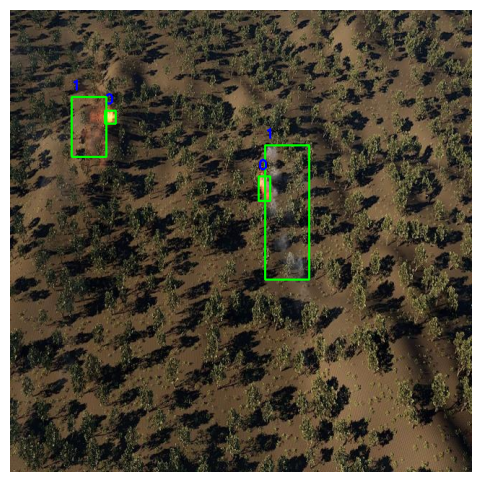

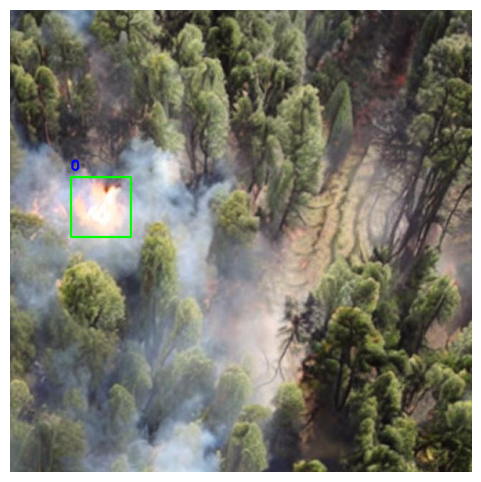

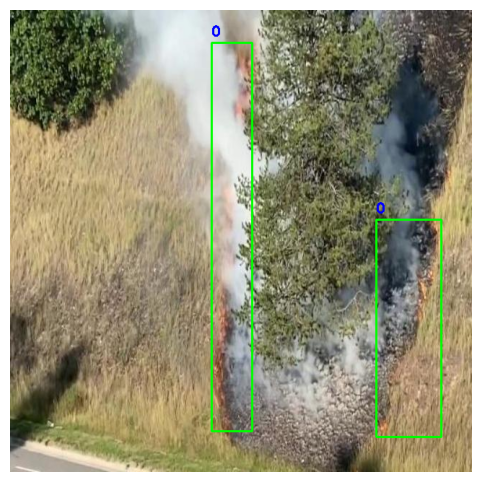

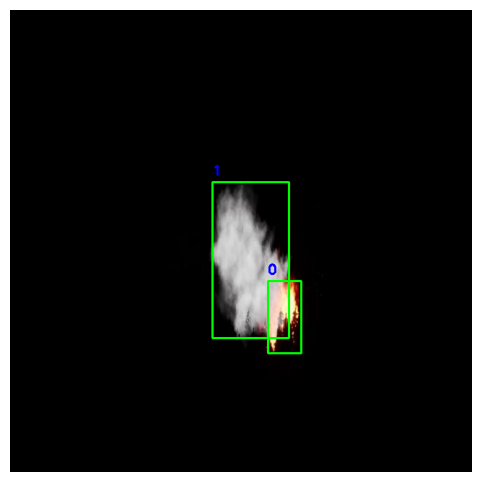

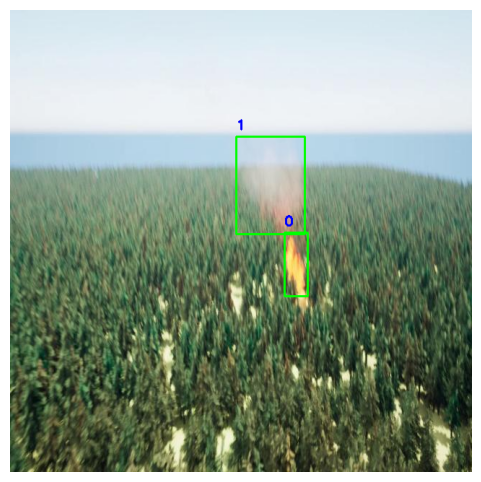


Processing /kaggle/working/wildfire-detection--1/valid - Found 1215 images, sampling 1215
Saved sampled dataset to /kaggle/working/wildfire-detection--1/valid_sampled
Displaying 5 samples:


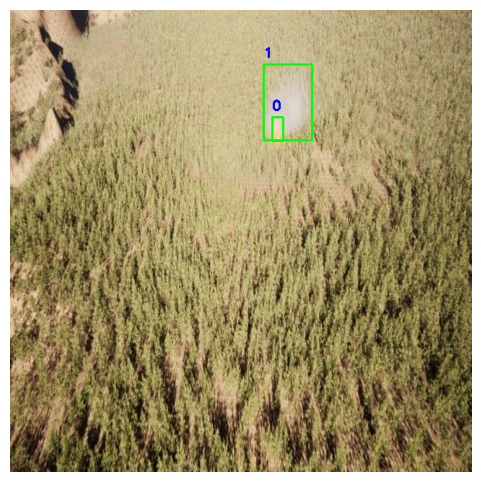

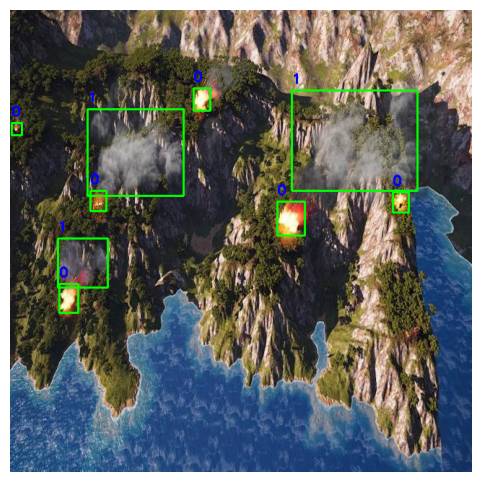

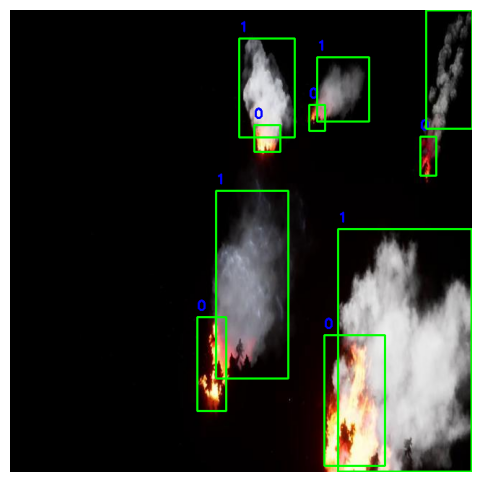

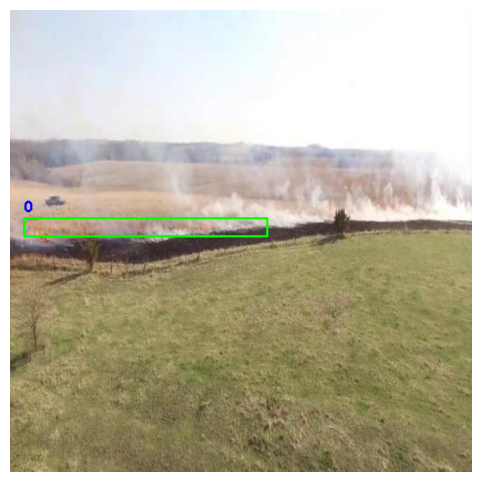

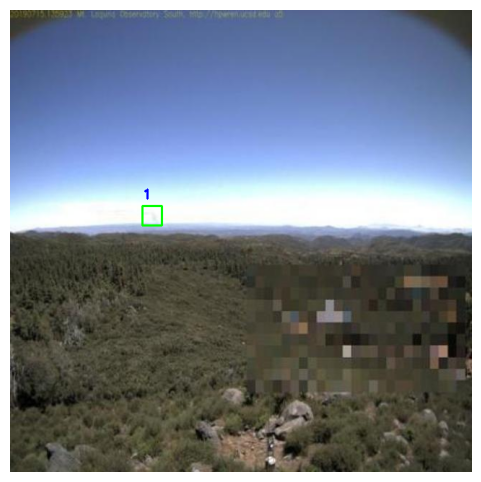


Processing /kaggle/working/wildfire-detection--1/test - Found 604 images, sampling 604
Saved sampled dataset to /kaggle/working/wildfire-detection--1/test_sampled
Displaying 5 samples:


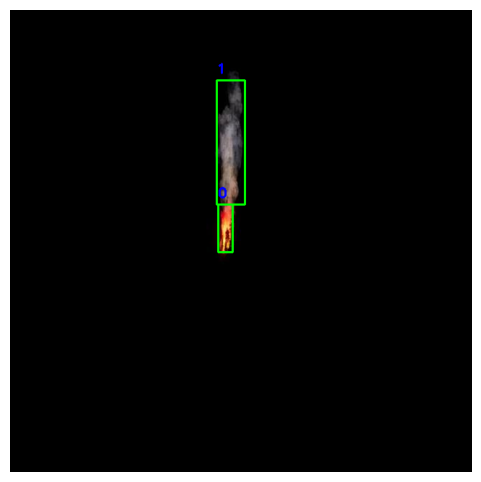

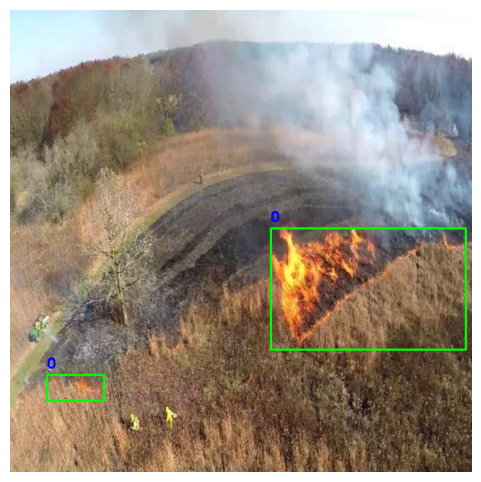

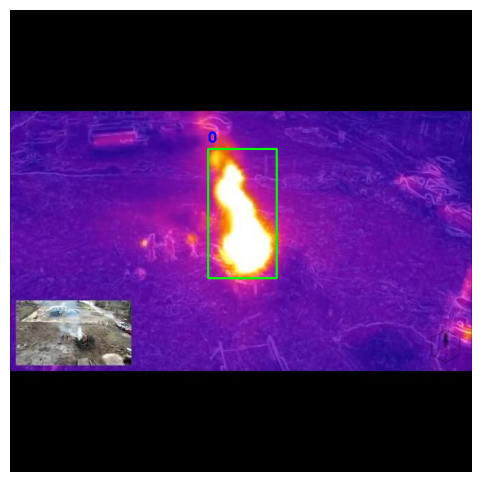

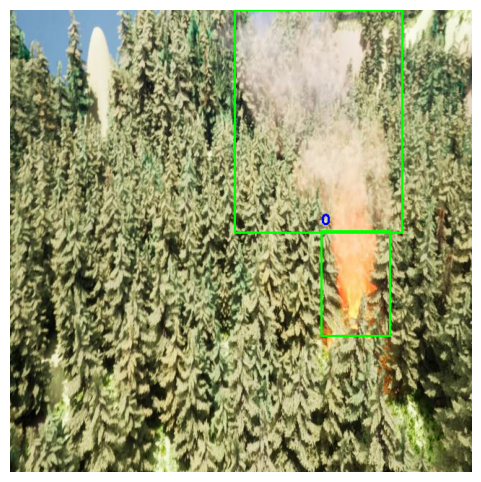

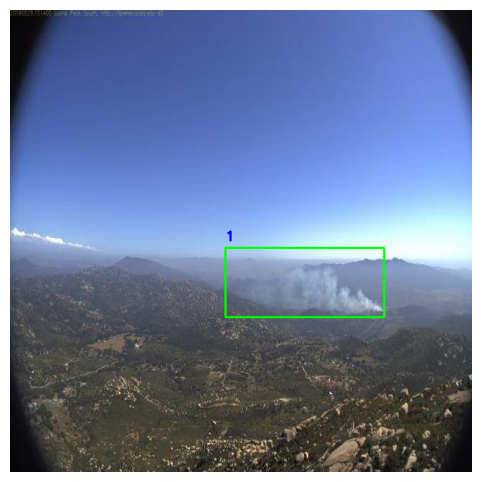

In [197]:
def display_yolo_image(img_path, lbl_path):
    """Display image with YOLO annotations"""
    img = cv2.imread(img_path)
    if img is None:
        print(f"Could not read image: {img_path}")
        return
        
    h, w = img.shape[:2]

    if not os.path.exists(lbl_path):
        print(f"No label file found: {lbl_path}")
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()
        return

    with open(lbl_path, "r") as f:
        for line in f:
            try:
                class_id, x_center, y_center, bw, bh = map(float, line.strip().split())
                x1 = int((x_center - bw/2) * w)
                y1 = int((y_center - bh/2) * h)
                x2 = int((x_center + bw/2) * w)
                y2 = int((y_center + bh/2) * h)
                cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(img, str(int(class_id)), (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
            except ValueError:
                print(f"Error parsing line in {lbl_path}: {line.strip()}")

    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def sample_and_display_dataset(base_dir, sample_ratio=0.5, display_samples=5, save_copy=False):
    """Process a dataset directory (train/test/valid)"""
    img_dir = os.path.join(base_dir, "images")
    lbl_dir = os.path.join(base_dir, "labels")
    
    if not os.path.exists(img_dir) or not os.path.exists(lbl_dir):
        print(f"Skipping {base_dir} - missing images or labels folder")
        return
    
    image_paths = sorted(glob(os.path.join(img_dir, "*.jpg")))
    if not image_paths:
        print(f"No images found in {img_dir}")
        return
        
    sample_size = int(len(image_paths) * sample_ratio)
    sampled_images = random.sample(image_paths, sample_size)
    
    print(f"\nProcessing {base_dir} - Found {len(image_paths)} images, sampling {sample_size}")
    
    if save_copy:
        new_dir = base_dir + "_sampled"
        new_img_dir = os.path.join(new_dir, "images")
        new_lbl_dir = os.path.join(new_dir, "labels")
        os.makedirs(new_img_dir, exist_ok=True)
        os.makedirs(new_lbl_dir, exist_ok=True)
        
        for img_path in sampled_images:
            lbl_path = os.path.join(lbl_dir, os.path.basename(img_path).replace(".jpg", ".txt"))

            shutil.copy(img_path, new_img_dir)

            if os.path.exists(lbl_path):
                shutil.copy(lbl_path, new_lbl_dir)
        print(f"Saved sampled dataset to {new_dir}")
    
    print(f"Displaying {min(display_samples, len(sampled_images))} samples:")
    for img_path in sampled_images[:display_samples]:
        lbl_path = os.path.join(lbl_dir, os.path.basename(img_path).replace(".jpg", ".txt"))
        display_yolo_image(img_path, lbl_path)

base_path = "/kaggle/working/wildfire-detection--1"
datasets = ["train", "valid", "test"]

for dataset in datasets:
    dataset_path = os.path.join(base_path, dataset)
    sample_and_display_dataset(dataset_path, sample_ratio=1, display_samples=5, save_copy=True)

In [198]:
yaml_path = "/kaggle/working/wildfire-detection--1/data.yaml"

try:
    with open(yaml_path, 'r') as file:
        data = yaml.safe_load(file)
    
    print("Class mappings:")
    for i, name in enumerate(data['names']):
        print(f"{i}: {name}")
    
    print("\nFull dataset config:")
    print(data)
except FileNotFoundError:
    print(f"Error: {yaml_path} not found!")
except Exception as e:
    print(f"Error reading YAML file: {e}")

Class mappings:
0: fire
1: smoke

Full dataset config:
{'names': ['fire', 'smoke'], 'nc': 2, 'roboflow': {'license': 'CC BY 4.0', 'project': 'wildfire-detection-3vcvr', 'url': 'https://universe.roboflow.com/waleed-azzi-o5bzp/wildfire-detection-3vcvr/dataset/1', 'version': 1, 'workspace': 'waleed-azzi-o5bzp'}, 'test': '../test/images', 'train': 'wildfire-detection--1/train/images', 'val': 'wildfire-detection--1/valid/images'}


In [199]:
!pip install ultralytics pyyaml

### Sampling Data

In [200]:
def create_subset(original_dir, subset_dir, sample_size=100):

    if os.path.exists(subset_dir):
        shutil.rmtree(subset_dir)

    os.makedirs(os.path.join(subset_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(subset_dir, 'labels'), exist_ok=True)

    img_files = glob(os.path.join(original_dir, 'images', '*.jpg'))
    annotated_imgs = [
        img for img in img_files
        if os.path.exists(img.replace('images', 'labels').replace('.jpg', '.txt'))
    ]

    sampled = random.sample(annotated_imgs, min(sample_size, len(annotated_imgs)))

    for img_path in sampled:
        shutil.copy(img_path, os.path.join(subset_dir, 'images'))
        label_path = img_path.replace('images', 'labels').replace('.jpg', '.txt')
        shutil.copy(label_path, os.path.join(subset_dir, 'labels'))

base_path = "/kaggle/working/wildfire-detection--1"

create_subset(os.path.join(base_path, 'train'), os.path.join(base_path, 'train_small'), 7500)
create_subset(os.path.join(base_path, 'valid'), os.path.join(base_path, 'valid_small'), 750)
create_subset(os.path.join(base_path, 'test'), os.path.join(base_path, 'test_small'), 750)

def print_dataset_sizes(base_path):
    dirs = ['train', 'train_small', 'valid', 'valid_small']
    for d in dirs:
        img_dir = os.path.join(base_path, d, 'images')
        lbl_dir = os.path.join(base_path, d, 'labels')

        num_imgs = len([f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
        num_lbls = len(glob(os.path.join(lbl_dir, '*.txt')))

        print(f"\nContents of '{os.path.join(base_path, d)}':")
        print(f"  Images: {num_imgs}")
        print(f"  Labels: {num_lbls}")

        if 'small' in d:
            expected = 550 if 'train' in d else 55
            if num_imgs != expected or num_lbls != expected:
                print(f"  ❌ Error: Expected {expected}, but got {num_imgs} images and {num_lbls} labels.")
            else:
                print("  ✅ Subset size correct.")

print_dataset_sizes(base_path)


Contents of '/kaggle/working/wildfire-detection--1/train':
  Images: 7531
  Labels: 7531

Contents of '/kaggle/working/wildfire-detection--1/train_small':
  Images: 7500
  Labels: 7500
  ❌ Error: Expected 550, but got 7500 images and 7500 labels.

Contents of '/kaggle/working/wildfire-detection--1/valid':
  Images: 1215
  Labels: 1215

Contents of '/kaggle/working/wildfire-detection--1/valid_small':
  Images: 750
  Labels: 750
  ❌ Error: Expected 55, but got 750 images and 750 labels.


In [201]:
yaml_path = os.path.join(base_path, 'data.yaml')
with open(yaml_path) as f:
    data = yaml.safe_load(f)

data['train'] = os.path.join(base_path, 'train_small')
data['val'] = os.path.join(base_path, 'valid_small')
data['test'] = os.path.join(base_path, 'test_small')

with open(os.path.join(base_path, 'data_small.yaml'), 'w') as f:
    yaml.dump(data, f)

### Data Augmentation

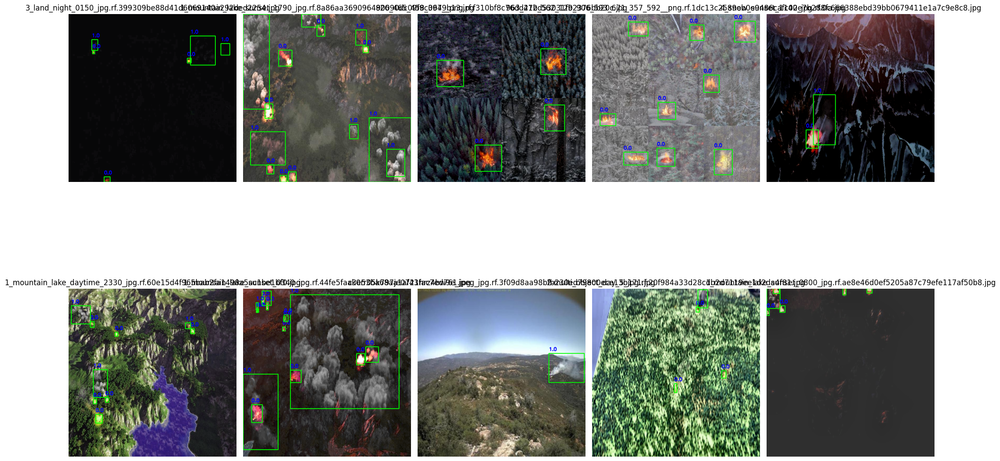

In [202]:
def get_transform(resize_dim=None):
    transforms = [
        A.RandomBrightnessContrast(p=0.2),
        A.CLAHE(clip_limit=4.0, p=0.1),
        A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=0.5),

        A.Normalize(mean=(0.0, 0.0, 0.0), std=(1.0, 1.0, 1.0), max_pixel_value=255.0)
    ]
    
    if resize_dim is not None:
        transforms.append(A.Resize(height=resize_dim, width=resize_dim))

    return A.Compose(
        transforms,
        bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels'])
    )

def draw_bboxes(image, bboxes, class_labels):
    """Draw bounding boxes on image"""
    h, w = image.shape[:2]
    for (xc, yc, bw, bh), cls in zip(bboxes, class_labels):
        x1 = int((xc - bw/2) * w)
        y1 = int((yc - bh/2) * h)
        x2 = int((xc + bw/2) * w)
        y2 = int((yc + bh/2) * h)
        
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(image, str(cls), (x1, y1 - 10), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
    return image

def augment_and_save(img_path, out_img_dir, out_lbl_dir, transform, sample_images=None):
    lbl_path = img_path.replace('/images/', '/labels/').replace('.jpg', '.txt')
    
    image = cv2.imread(img_path)
    h, w = image.shape[:2]

    class_labels, bboxes = [], []
    with open(lbl_path) as f:
        for line in f:
            cls, xc, yc, bw, bh = map(float, line.split())
            class_labels.append(int(cls))
            bboxes.append([xc, yc, bw, bh])

    augmented = transform(image=image, bboxes=bboxes, class_labels=class_labels)
    aug_img = augmented['image']
    aug_bboxes = augmented['bboxes']
    aug_classes = augmented['class_labels']

    basename = os.path.basename(img_path)
    aug_path = os.path.join(out_img_dir, basename)
    cv2.imwrite(aug_path, aug_img)

    if sample_images is not None and len(sample_images) < 10:
        img_with_boxes = draw_bboxes(aug_img.copy(), aug_bboxes, aug_classes)
        sample_images.append((img_with_boxes, basename))

    out_lbl = os.path.join(out_lbl_dir, basename.replace('.jpg', '.txt'))
    with open(out_lbl, 'w') as f:
        for cls, (xc, yc, bw, bh) in zip(aug_classes, aug_bboxes):
            f.write(f"{cls} {xc:.6f} {yc:.6f} {bw:.6f} {bh:.6f}\n")

train_img_dir = "/kaggle/working/wildfire-detection--1/train_small/images"
out_img_dir = "/kaggle/working/wildfire-detection--1/train_aug/images"
out_lbl_dir = "/kaggle/working/wildfire-detection--1/train_aug/labels"

os.makedirs(out_img_dir, exist_ok=True)
os.makedirs(out_lbl_dir, exist_ok=True)

sample_images = []

resize_dim = 640
transform = get_transform(resize_dim)

img_paths = glob(os.path.join(train_img_dir, "*.jpg"))
for img_path in img_paths:
    augment_and_save(img_path, out_img_dir, out_lbl_dir, transform, sample_images)

plt.figure(figsize=(20, 15))
for i, (img, title) in enumerate(sample_images[:10], 1):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(2, 5, i)
    plt.imshow(img_rgb)
    plt.title(title)
    plt.axis('off')
plt.tight_layout()
plt.show()

### Training

In [203]:
model = YOLO('yolov8s.pt')  
print("BASE PATH:", base_path)

results = model.train(
    data=os.path.join(base_path, 'data_small.yaml'),
    epochs=100,
    imgsz=640,
    batch=16,
    name='fire_detection_small',
    exist_ok = True
)

BASE PATH: /kaggle/working/wildfire-detection--1
Ultralytics 8.3.112 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/kaggle/working/wildfire-detection--1/data_small.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=fire_detection_small, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_

In [204]:
best_model = YOLO(os.path.join('runs', 'detect', 'fire_detection_small', 'weights', 'best.pt'))

print("BASE PATH:", base_path)

metrics = best_model.val(
    data=os.path.join(base_path, 'data_small.yaml'),
    split='test' 
)

print(metrics.box.map)  

BASE PATH: /kaggle/working/wildfire-detection--1
Ultralytics 8.3.112 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,126,358 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 908.8±317.6 MB/s, size: 53.1 KB)
val: Scanning /kaggle/working/wildfire-detection--1/test_small/labels... 604 images, 0 backgrounds, 0 corrupt: 100%|██████████| 604/604 [00:00<00:00, 1360.77it/s]
val: New cache created: /kaggle/working/wildfire-detection--1/test_small/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:09<00:00,  4.14it/s]
                   all        604       1790      0.829      0.772       0.84      0.501
                  fire        473       1121      0.816       0.74      0.816      0.462
                 smoke        381        669      0.842      0.804      0.864       0.54
Speed: 0.7ms preprocess, 9.6ms inference, 0.0ms l

We got decent Box Precision as well as Recall and mAP50. The only figure a little less is mAP50-95, it is less as it is a robust measure and is usually low in forest fire detection models.


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_daytime_3830_jpg.rf.b5c3804bc2f48fbe8ab5eec46ceb9afa.jpg: 640x640 3 fires, 2 smokes, 16.2ms
Speed: 1.7ms preprocess, 16.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


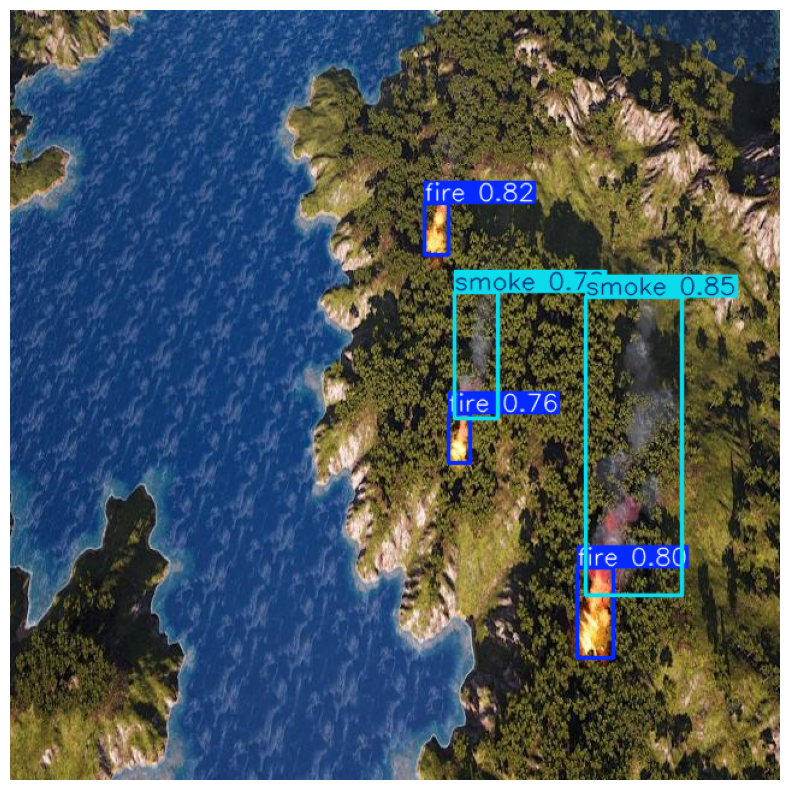


image 1/1 /kaggle/working/wildfire-detection--1/test/images/ck0tx7k0tr5rz0794r2twuz1o_jpeg_jpg.rf.5c23cf1777e805b1e3155ba78b6513f8.jpg: 640x640 1 smoke, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


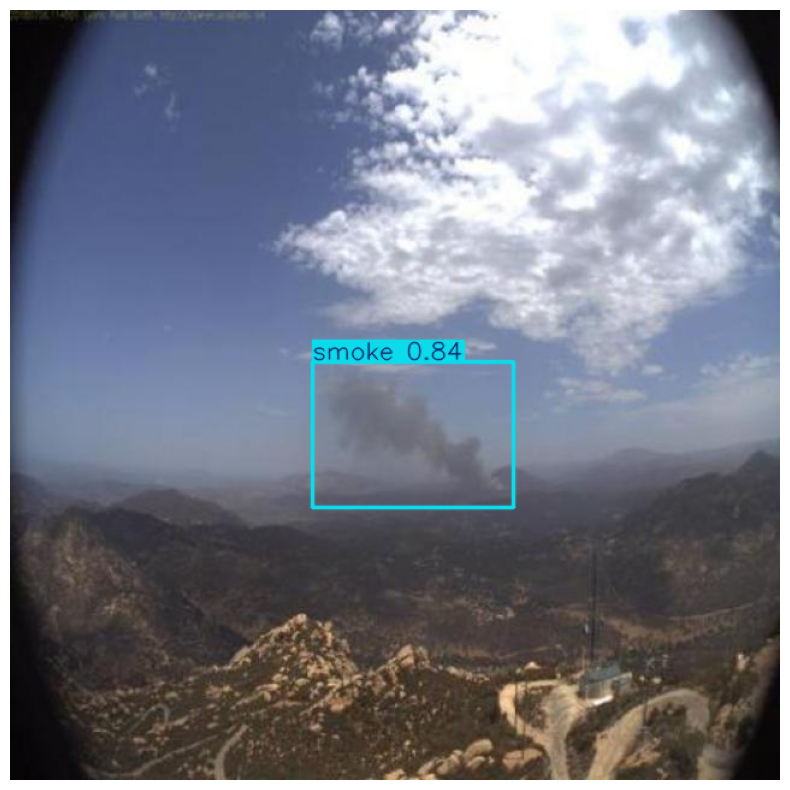


image 1/1 /kaggle/working/wildfire-detection--1/test/images/3-single_fire_183_jpg.rf.52ff1ddd1cd60dfd98147503ee87a2a8.jpg: 640x640 1 fire, 1 smoke, 16.4ms
Speed: 2.0ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


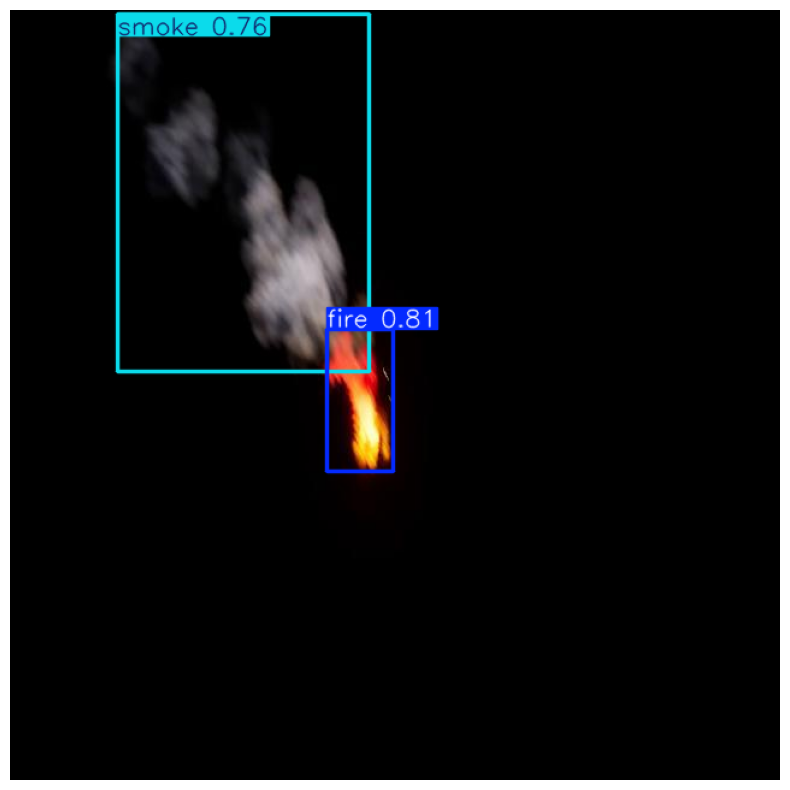


image 1/1 /kaggle/working/wildfire-detection--1/test/images/fire-439-_png_jpg.rf.350d3bd181fefdb4ccada2ce80182255.jpg: 640x640 1 fire, 16.5ms
Speed: 2.2ms preprocess, 16.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


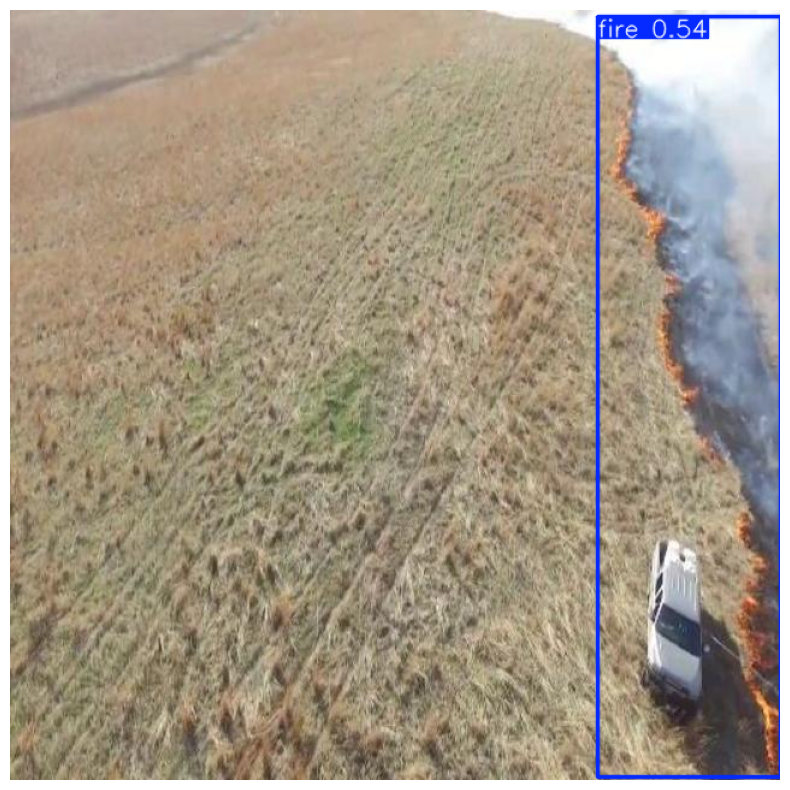


image 1/1 /kaggle/working/wildfire-detection--1/test/images/CBERS_4A_WFI_20200505_220_132_L2_4591_3770_3_png_jpg.rf.2ffde13c1427deffc7923ab33362ea16.jpg: 640x640 5 fires, 16.4ms
Speed: 2.6ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


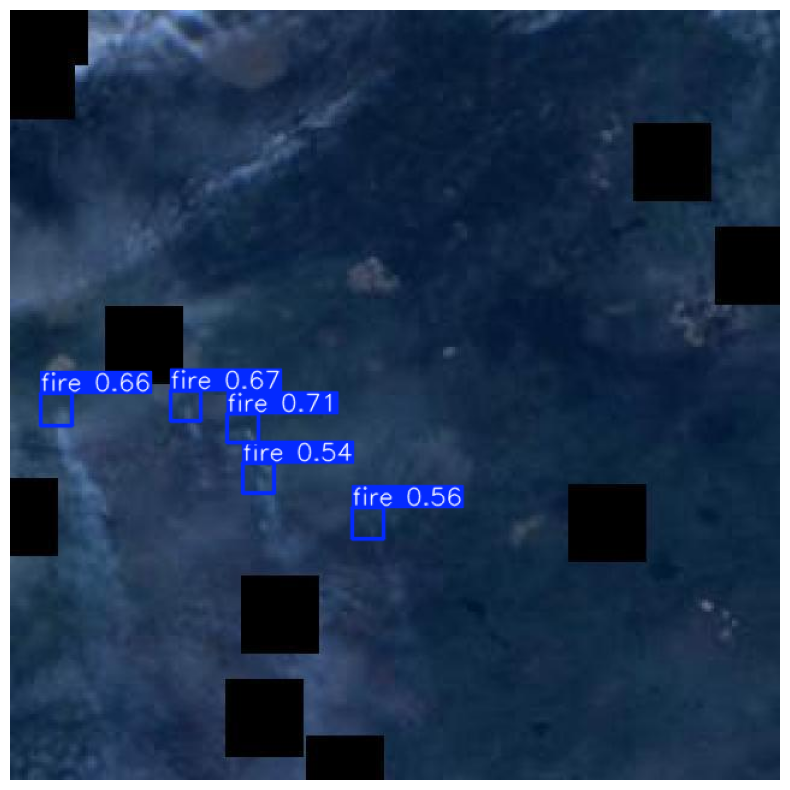


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_night_0620_jpg.rf.ee1a19a90d3b70057cbd85bca40489f7.jpg: 640x640 10 fires, 4 smokes, 16.3ms
Speed: 2.2ms preprocess, 16.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


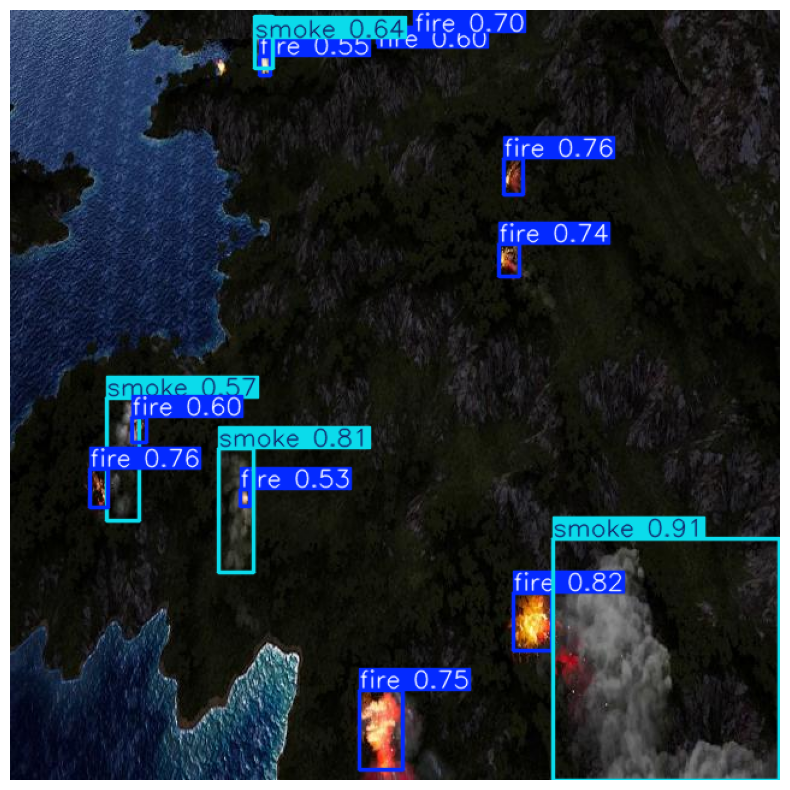


image 1/1 /kaggle/working/wildfire-detection--1/test/images/Car-Fire-as-seen-with-the-FLIR-Vue-Pro-Thermal-Imaging-Camera-for-UAVs-0-11-screenshot_png.rf.2abbbc925c82952efd484baf56965756.jpg: 640x640 1 fire, 16.3ms
Speed: 2.3ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


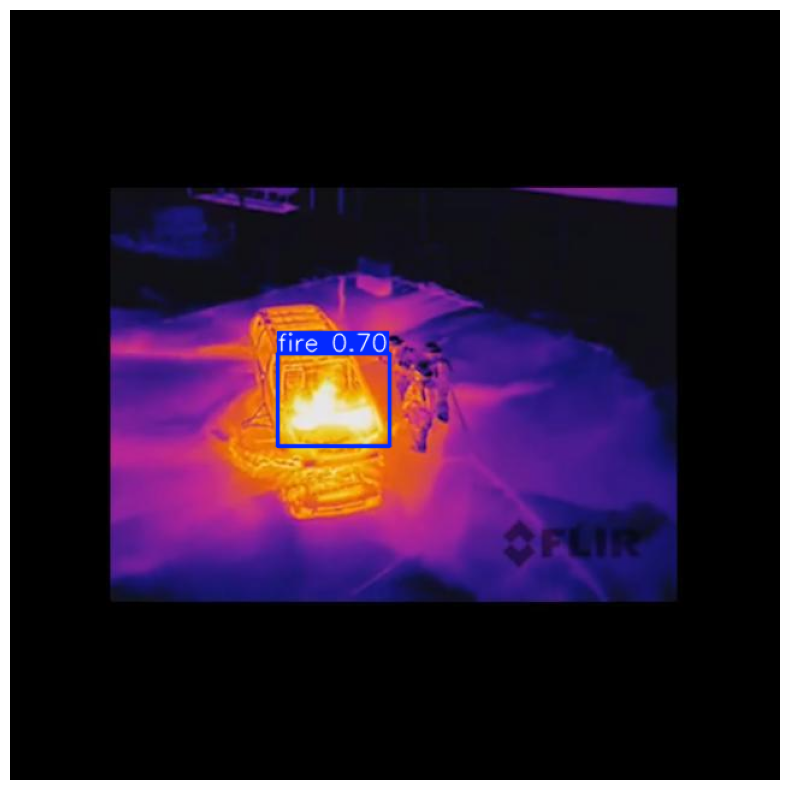


image 1/1 /kaggle/working/wildfire-detection--1/test/images/ck0kosu846k350794gya7bot0_jpeg_jpg.rf.1522eb6a85b039e96a6d7e9fc2597878.jpg: 640x640 1 smoke, 16.4ms
Speed: 2.8ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


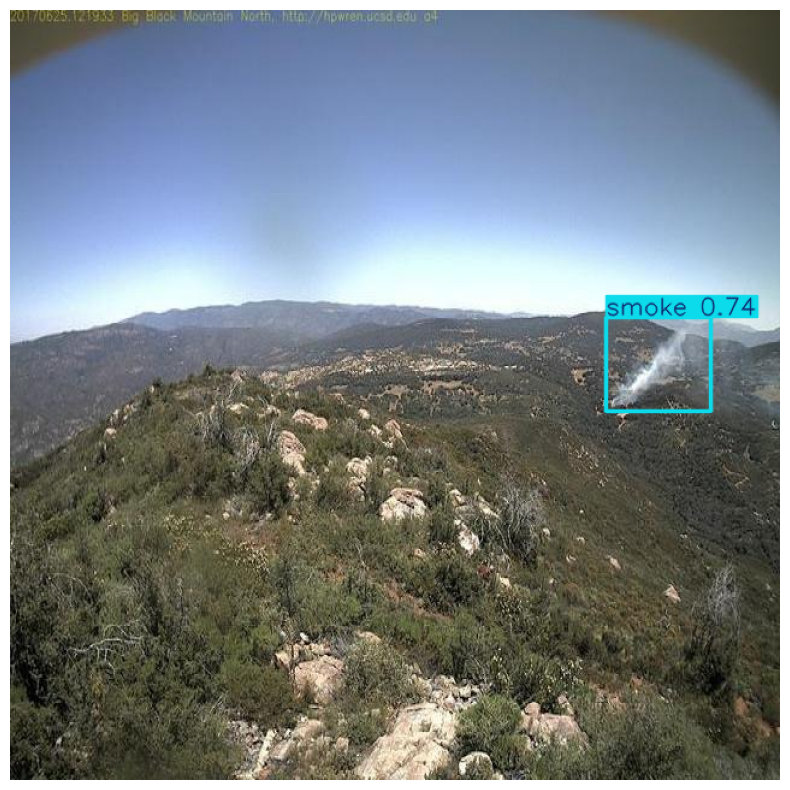


image 1/1 /kaggle/working/wildfire-detection--1/test/images/ck0u14y7arp5c0794llhscme5_jpeg_jpg.rf.76eb758f2ea9b3a99a01b399b948efa6.jpg: 640x640 1 smoke, 16.3ms
Speed: 2.5ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


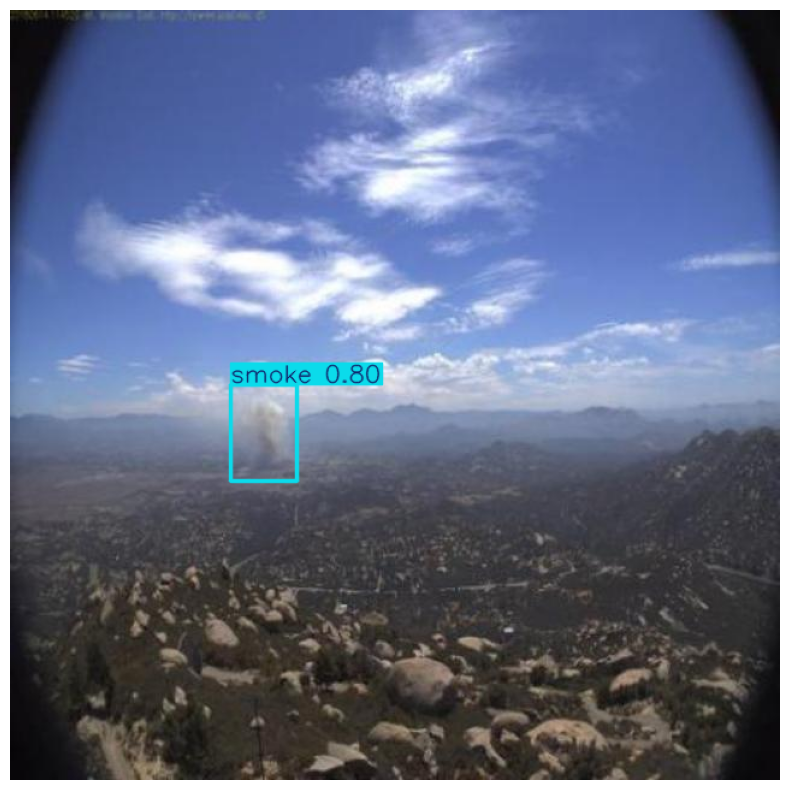


image 1/1 /kaggle/working/wildfire-detection--1/test/images/2-single_object_day_144_jpg.rf.7c9dd00000a590b16ccef9b2e46e0091.jpg: 640x640 1 fire, 1 smoke, 16.5ms
Speed: 2.6ms preprocess, 16.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


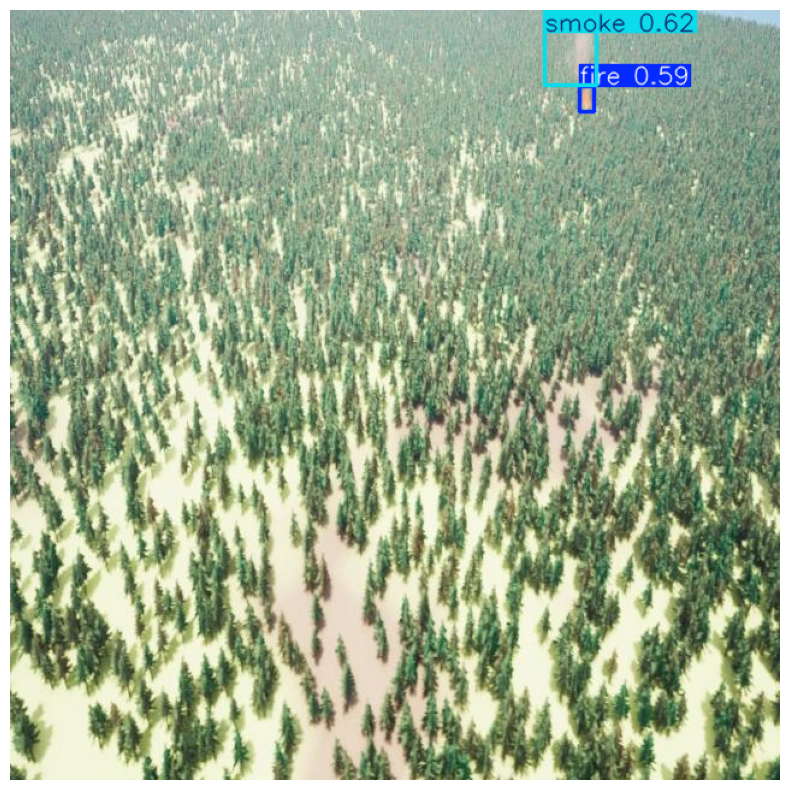


image 1/1 /kaggle/working/wildfire-detection--1/test/images/4_snow_night_0170_jpg.rf.e784d1335c9498c986ca81fdecf08532.jpg: 640x640 2 fires, 1 smoke, 16.4ms
Speed: 2.2ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


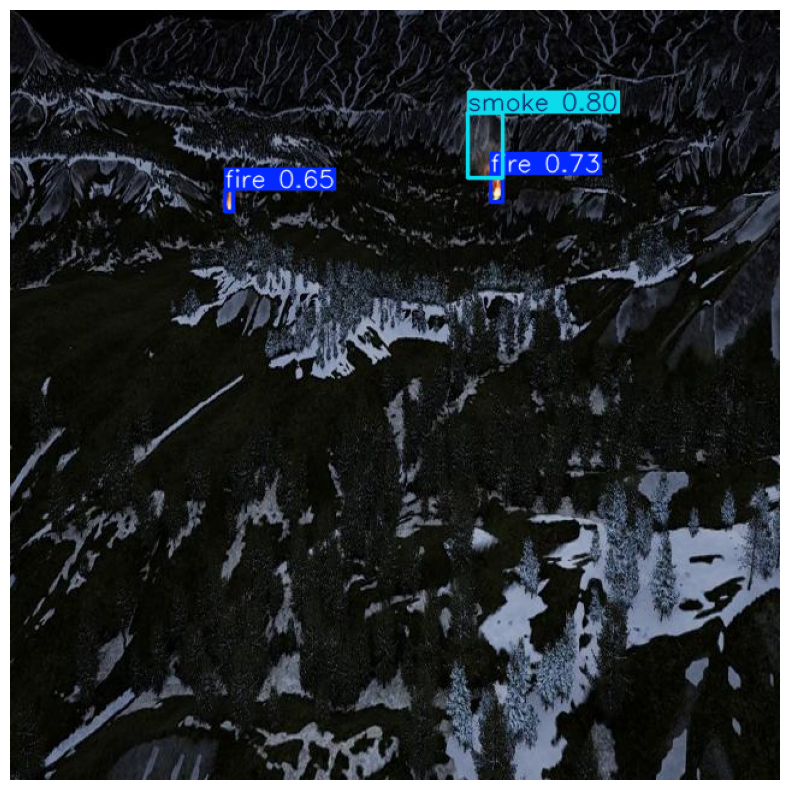


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_night_0000_jpg.rf.bf6d8f20d8544db527771c81e69d1aad.jpg: 640x640 5 fires, 4 smokes, 16.3ms
Speed: 3.0ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


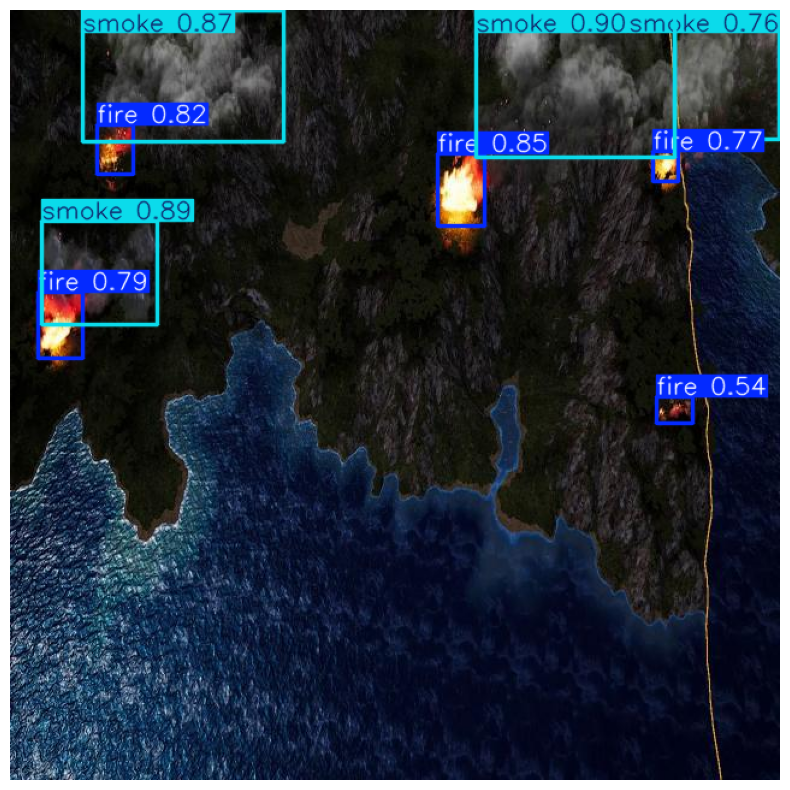


image 1/1 /kaggle/working/wildfire-detection--1/test/images/2-singlle_object_night_46_jpg.rf.2b89b0be02858fef34d378d3d09b6ec5.jpg: 640x640 1 fire, 1 smoke, 16.4ms
Speed: 3.6ms preprocess, 16.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


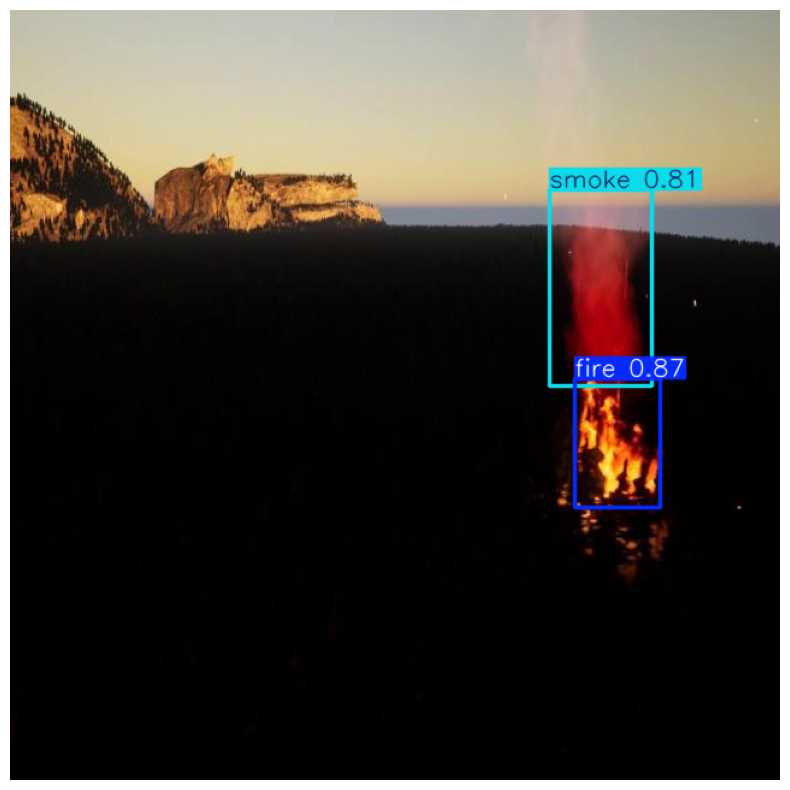


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_daytime_3110_jpg.rf.6e4c0dc9607142a8d6abe642488060dd.jpg: 640x640 5 fires, 2 smokes, 16.3ms
Speed: 3.4ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


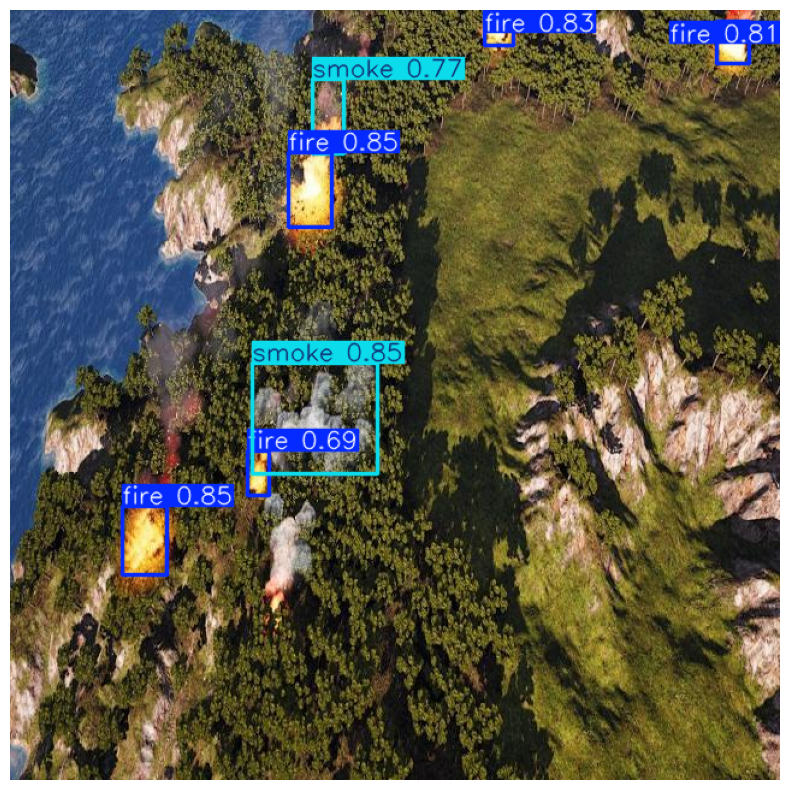


image 1/1 /kaggle/working/wildfire-detection--1/test/images/3-single_fire_45_jpg.rf.91002792586fd819407841cc1802e751.jpg: 640x640 1 fire, 1 smoke, 16.3ms
Speed: 3.2ms preprocess, 16.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


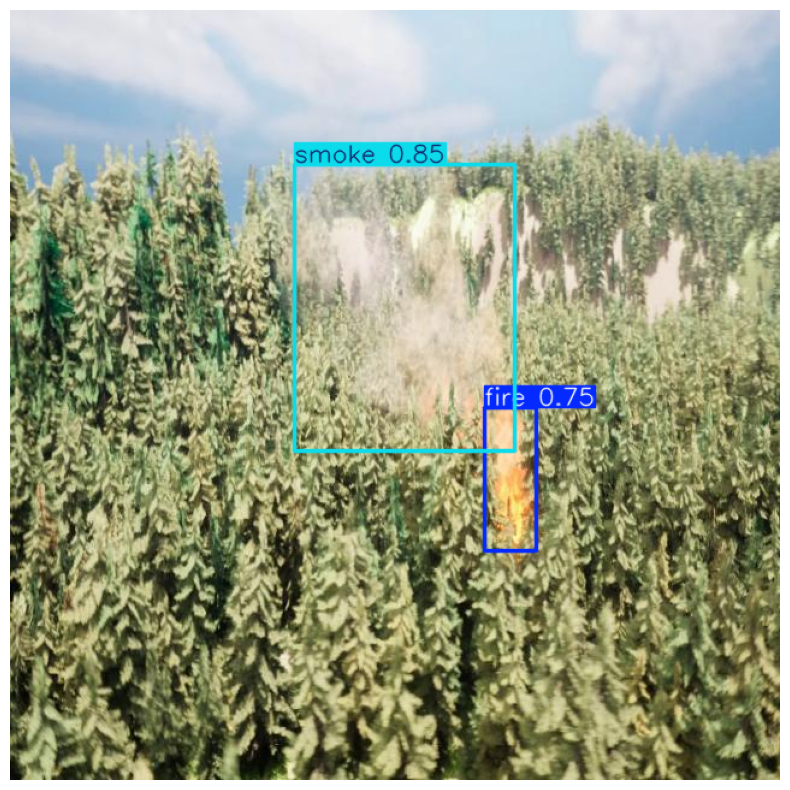


image 1/1 /kaggle/working/wildfire-detection--1/test/images/f-75-_jpg.rf.519d7fc17e0c1ec7d73fe5201e43bbe3.jpg: 640x640 6 fires, 16.3ms
Speed: 3.0ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


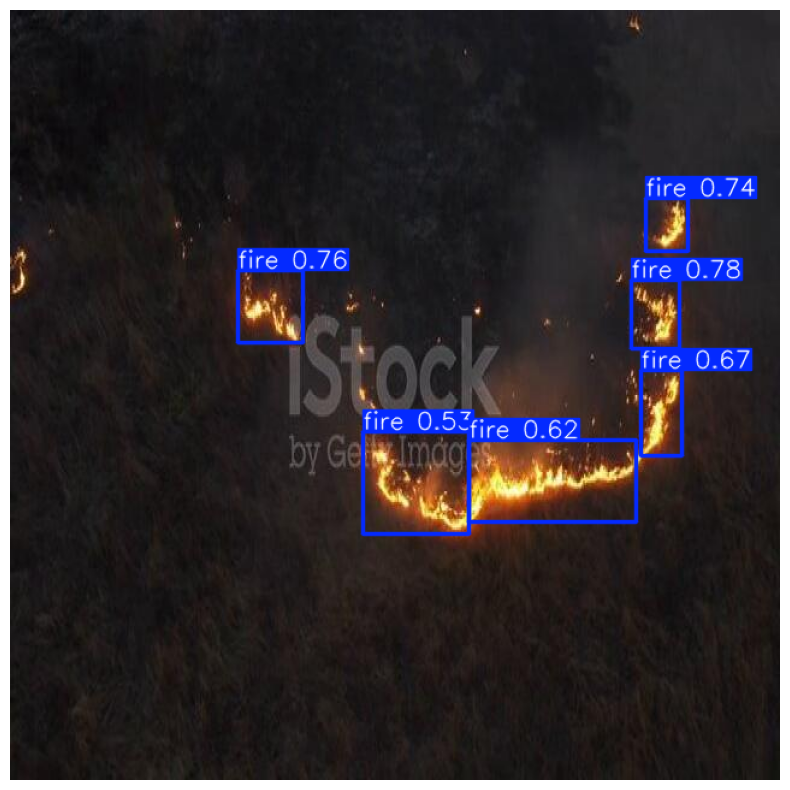


image 1/1 /kaggle/working/wildfire-detection--1/test/images/CBERS_4A_WFI_20200504_214_140_L4_5964_3328_2_png_jpg.rf.30014fad9064db85b1ebbdb5a623041a.jpg: 640x640 (no detections), 16.4ms
Speed: 3.7ms preprocess, 16.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


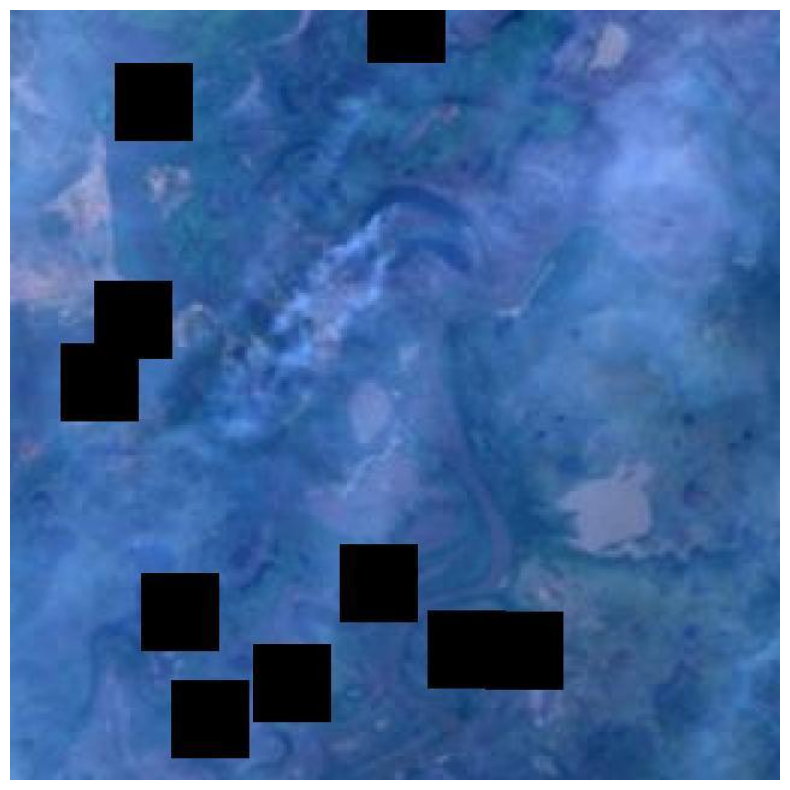


image 1/1 /kaggle/working/wildfire-detection--1/test/images/155A_gt_png.rf.5354362a95309096ae458fe04e754b8c.jpg: 640x640 1 fire, 16.4ms
Speed: 3.8ms preprocess, 16.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


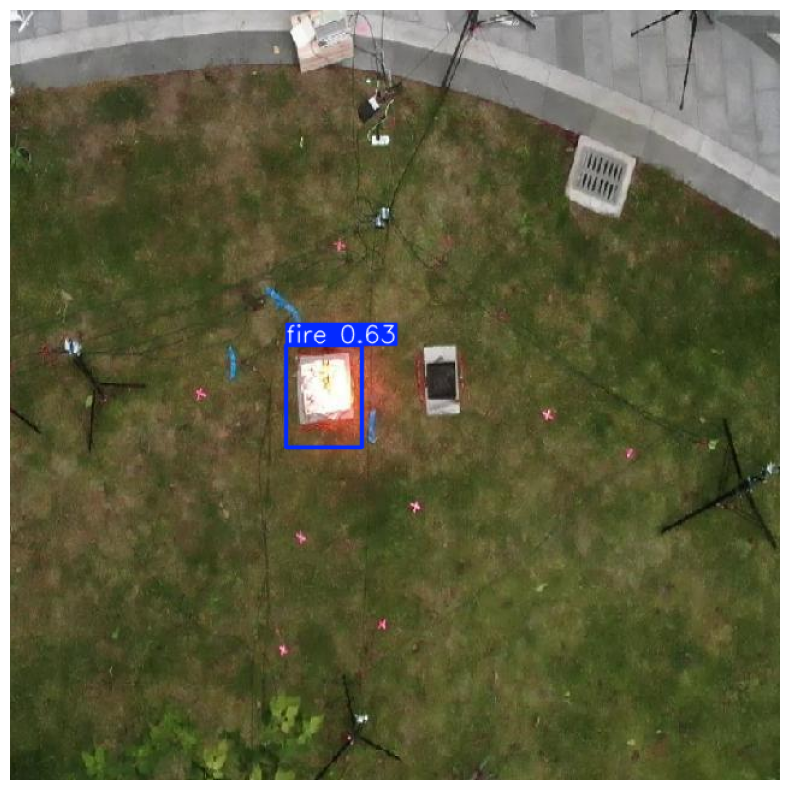


image 1/1 /kaggle/working/wildfire-detection--1/test/images/44_134_45_142__png.rf.f2614fbbb3674986deb8501edf607dd0.jpg: 640x640 4 fires, 16.3ms
Speed: 3.0ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


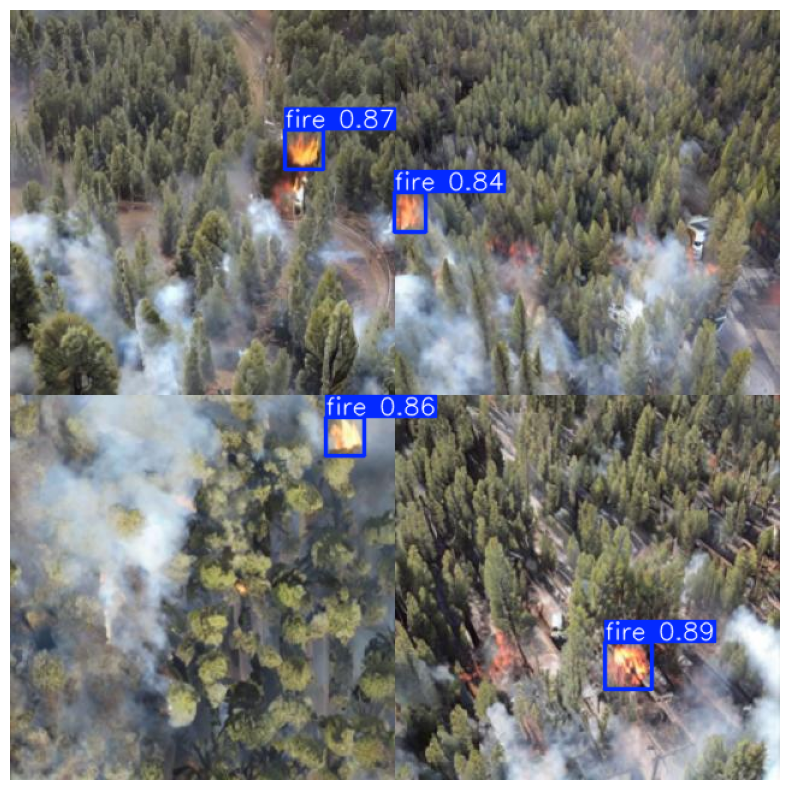


image 1/1 /kaggle/working/wildfire-detection--1/test/images/2-multi_object_day_178_jpg.rf.63837233d49daabab94d6d86457b7900.jpg: 640x640 2 fires, 1 smoke, 16.3ms
Speed: 3.1ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


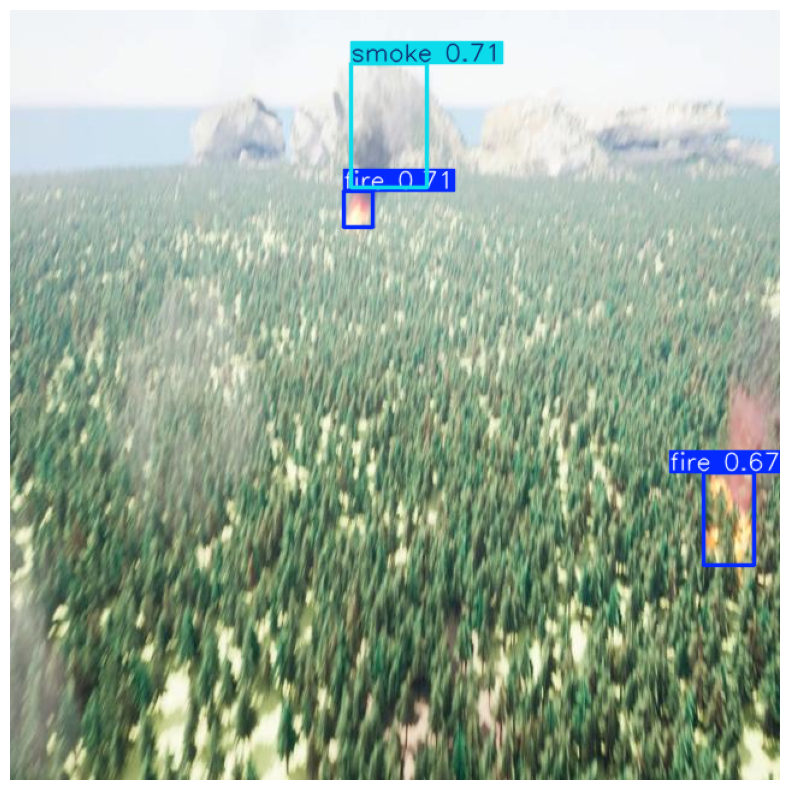

In [205]:
test_images = glob.glob(os.path.join(base_path, 'test', 'images', '*.jpg'))

random_images = random.sample(test_images, min(20, len(test_images)))

for img_path in random_images:
    results = best_model.predict(img_path, conf=0.5)
    res_plotted = results[0].plot()  
    plt.figure(figsize=(10, 10))
    plt.imshow(res_plotted[..., ::-1])
    plt.axis('off')
    plt.show()

### Loading clip model

In [206]:
model_name = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(model_name)
processor = CLIPProcessor.from_pretrained(model_name)

device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model.to(device)

CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPSdpaAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e

In [207]:
label_dict = {
    "intensity": ["low intensity", "medium intensity", "high intensity"],
    "control":   ["controlled fire", "Mildily in control" , "uncontrolled fire"],
    "risk":      ["low risk", "medium risk", "high risk"],
}

def classify_crop(crop, labels):
    inputs = processor(text=labels, images=crop,
                       return_tensors="pt", padding=True).to(device)
    clip_model.eval()
    with torch.no_grad():
        logits = clip_model(**inputs).logits_per_image  
    probs = logits.softmax(dim=-1)                    
    idx   = probs.argmax(dim=-1).item()
    return labels[idx], probs[0, idx].item()

### Performing Analysis


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_daytime_3830_jpg.rf.b5c3804bc2f48fbe8ab5eec46ceb9afa.jpg: 640x640 3 fires, 2 smokes, 16.2ms
Speed: 1.5ms preprocess, 16.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


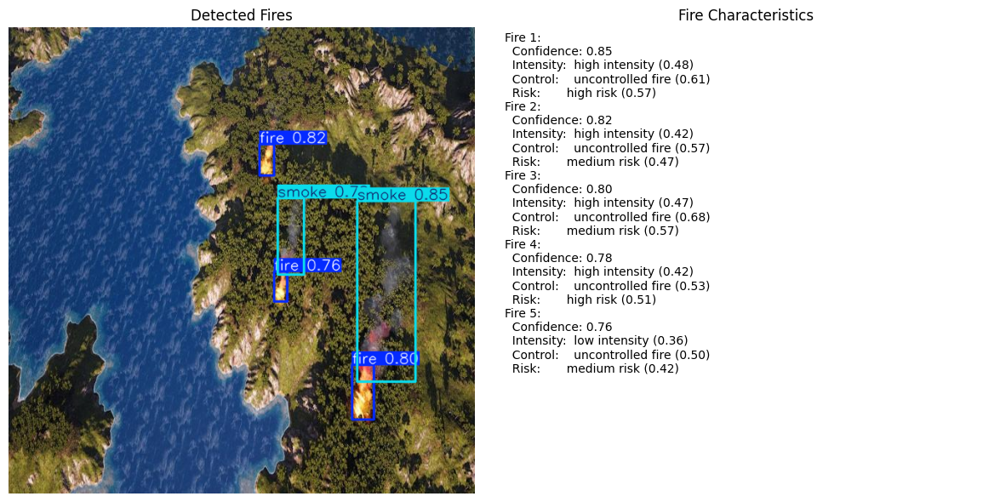


image 1/1 /kaggle/working/wildfire-detection--1/test/images/ck0tx7k0tr5rz0794r2twuz1o_jpeg_jpg.rf.5c23cf1777e805b1e3155ba78b6513f8.jpg: 640x640 1 smoke, 15.7ms
Speed: 1.7ms preprocess, 15.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


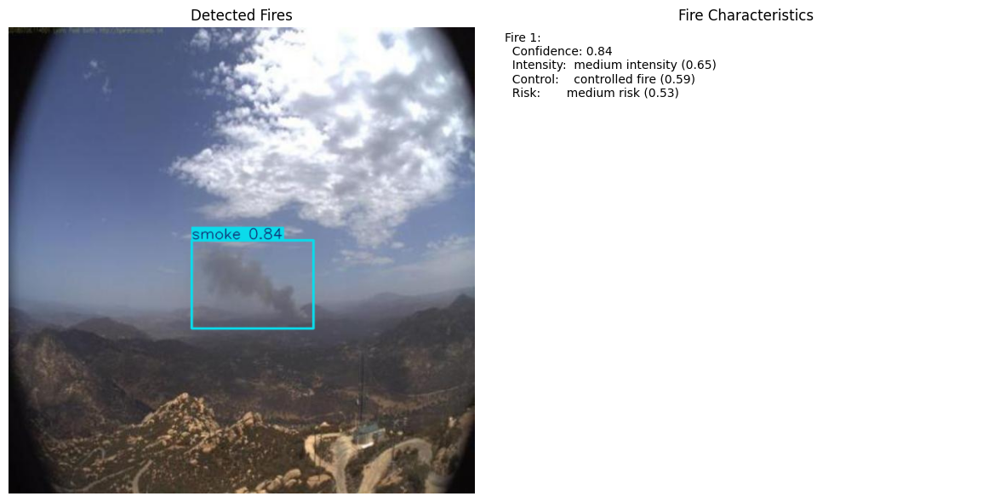


image 1/1 /kaggle/working/wildfire-detection--1/test/images/3-single_fire_183_jpg.rf.52ff1ddd1cd60dfd98147503ee87a2a8.jpg: 640x640 1 fire, 1 smoke, 15.8ms
Speed: 2.0ms preprocess, 15.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


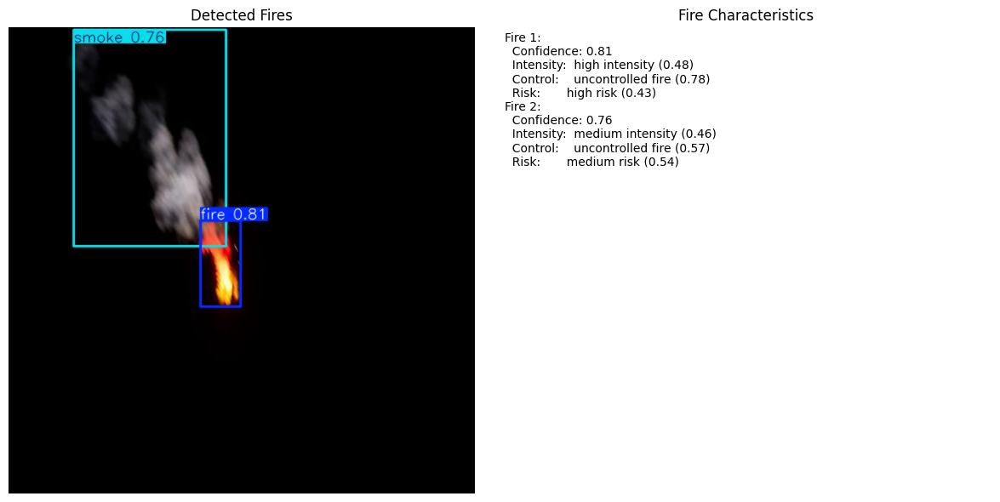


image 1/1 /kaggle/working/wildfire-detection--1/test/images/fire-439-_png_jpg.rf.350d3bd181fefdb4ccada2ce80182255.jpg: 640x640 1 fire, 15.6ms
Speed: 3.2ms preprocess, 15.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


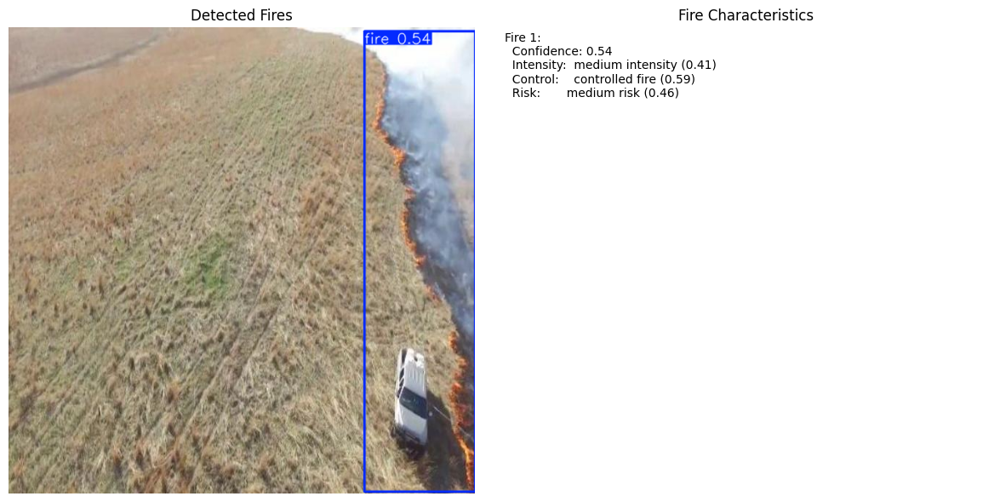


image 1/1 /kaggle/working/wildfire-detection--1/test/images/CBERS_4A_WFI_20200505_220_132_L2_4591_3770_3_png_jpg.rf.2ffde13c1427deffc7923ab33362ea16.jpg: 640x640 5 fires, 16.3ms
Speed: 3.0ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


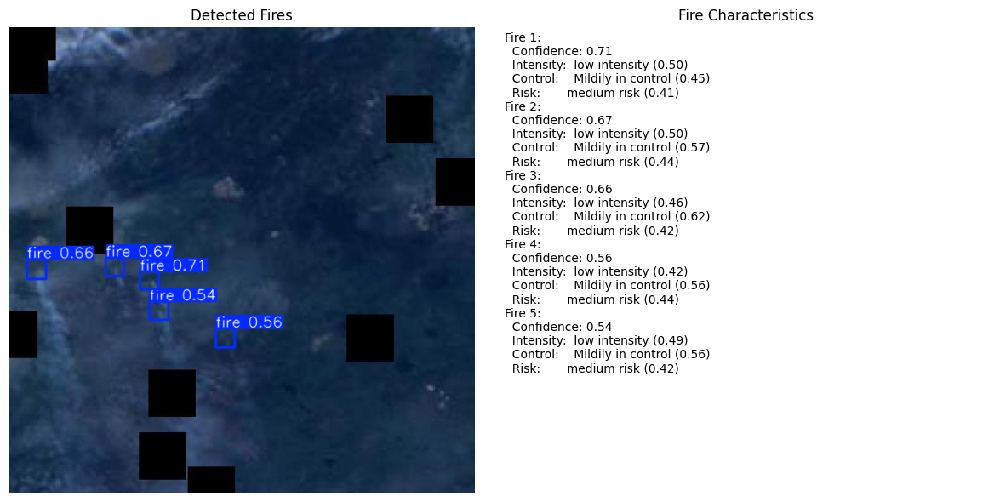


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_night_0620_jpg.rf.ee1a19a90d3b70057cbd85bca40489f7.jpg: 640x640 10 fires, 4 smokes, 14.8ms
Speed: 3.8ms preprocess, 14.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


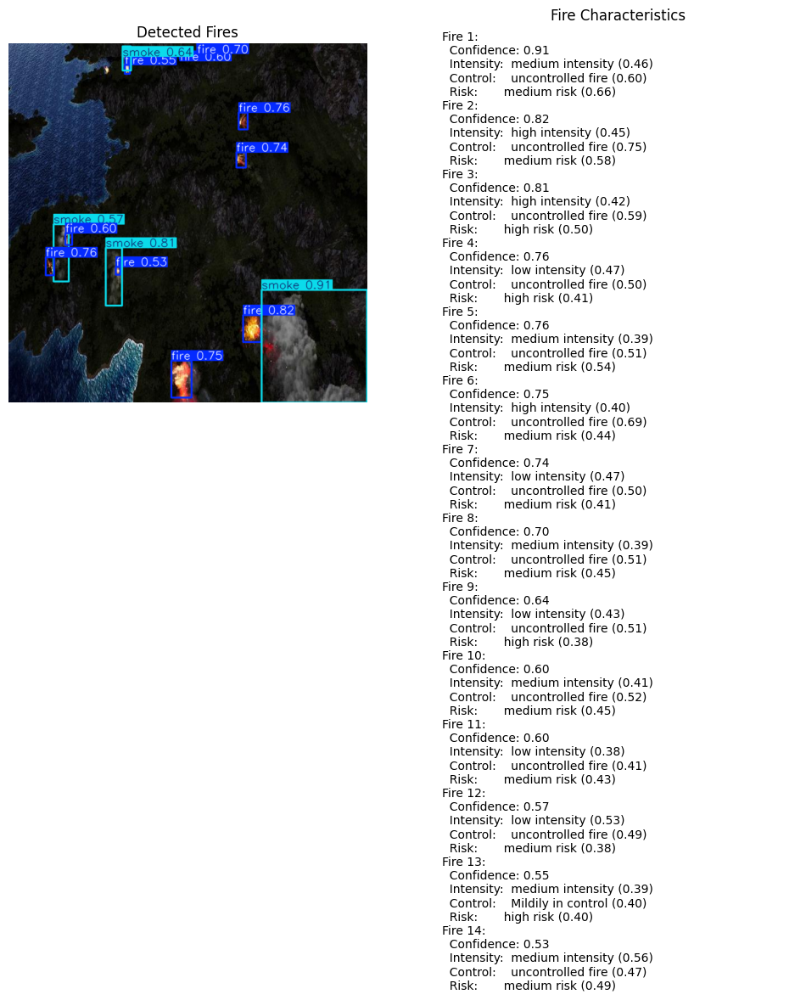


image 1/1 /kaggle/working/wildfire-detection--1/test/images/Car-Fire-as-seen-with-the-FLIR-Vue-Pro-Thermal-Imaging-Camera-for-UAVs-0-11-screenshot_png.rf.2abbbc925c82952efd484baf56965756.jpg: 640x640 1 fire, 14.9ms
Speed: 3.7ms preprocess, 14.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


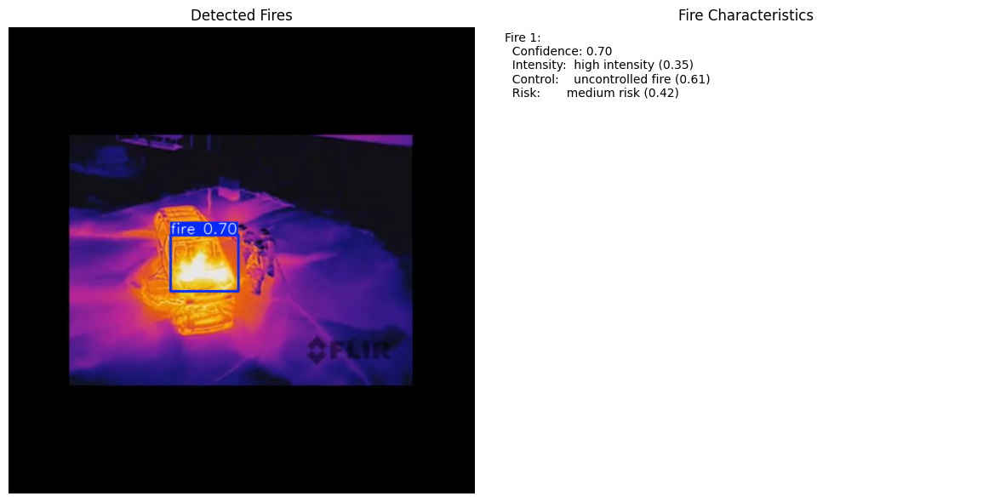


image 1/1 /kaggle/working/wildfire-detection--1/test/images/ck0kosu846k350794gya7bot0_jpeg_jpg.rf.1522eb6a85b039e96a6d7e9fc2597878.jpg: 640x640 1 smoke, 16.4ms
Speed: 3.8ms preprocess, 16.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


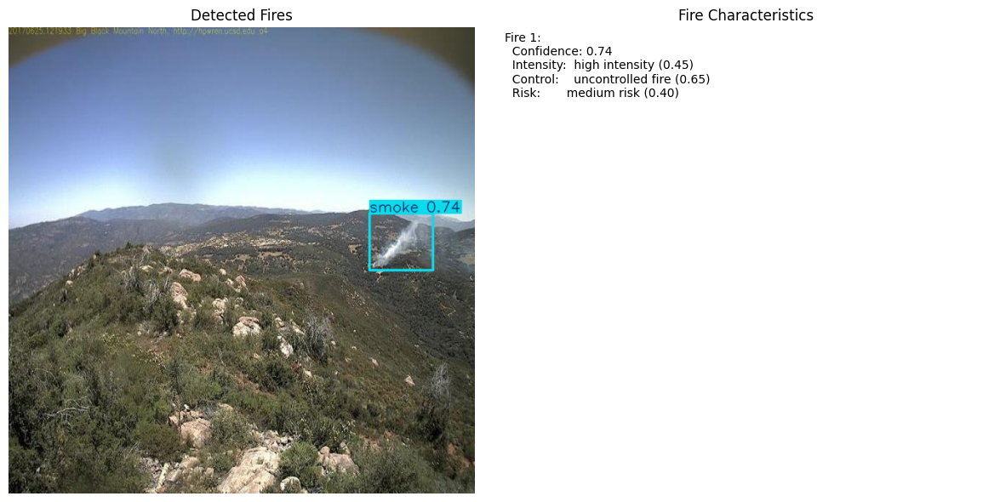


image 1/1 /kaggle/working/wildfire-detection--1/test/images/ck0u14y7arp5c0794llhscme5_jpeg_jpg.rf.76eb758f2ea9b3a99a01b399b948efa6.jpg: 640x640 1 smoke, 16.4ms
Speed: 3.3ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


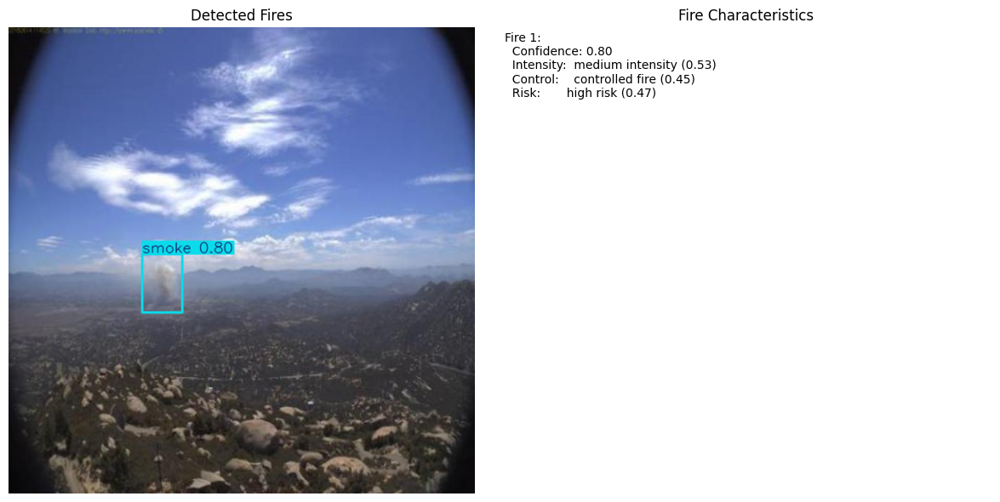


image 1/1 /kaggle/working/wildfire-detection--1/test/images/2-single_object_day_144_jpg.rf.7c9dd00000a590b16ccef9b2e46e0091.jpg: 640x640 1 fire, 1 smoke, 16.4ms
Speed: 4.0ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


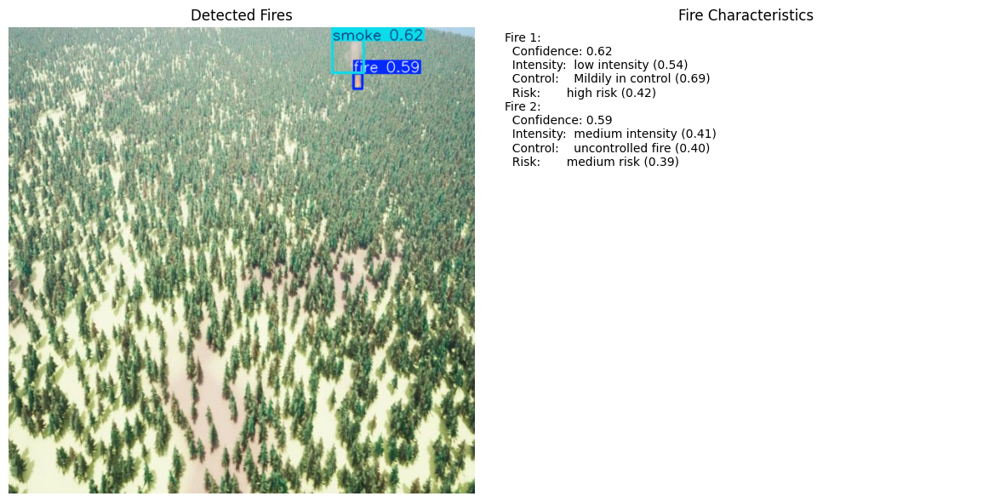


image 1/1 /kaggle/working/wildfire-detection--1/test/images/4_snow_night_0170_jpg.rf.e784d1335c9498c986ca81fdecf08532.jpg: 640x640 2 fires, 1 smoke, 16.4ms
Speed: 3.6ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


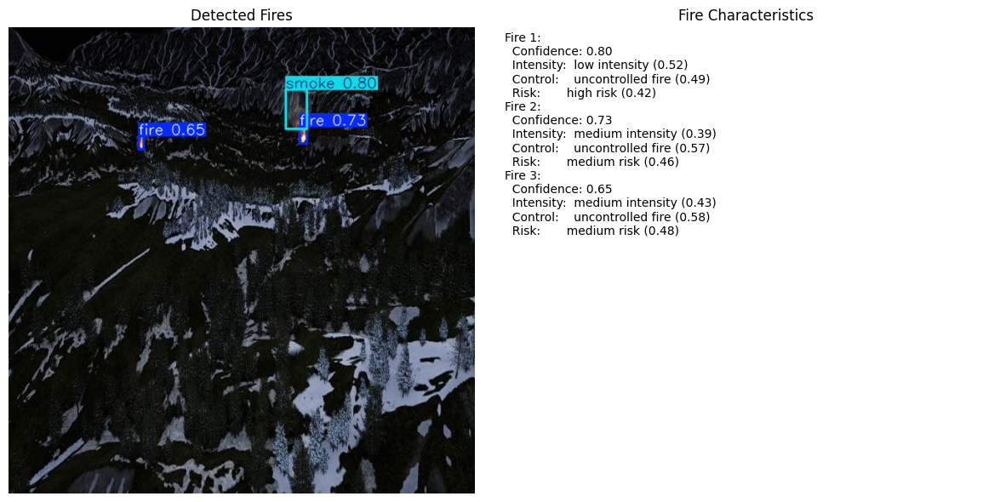


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_night_0000_jpg.rf.bf6d8f20d8544db527771c81e69d1aad.jpg: 640x640 5 fires, 4 smokes, 16.0ms
Speed: 3.9ms preprocess, 16.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


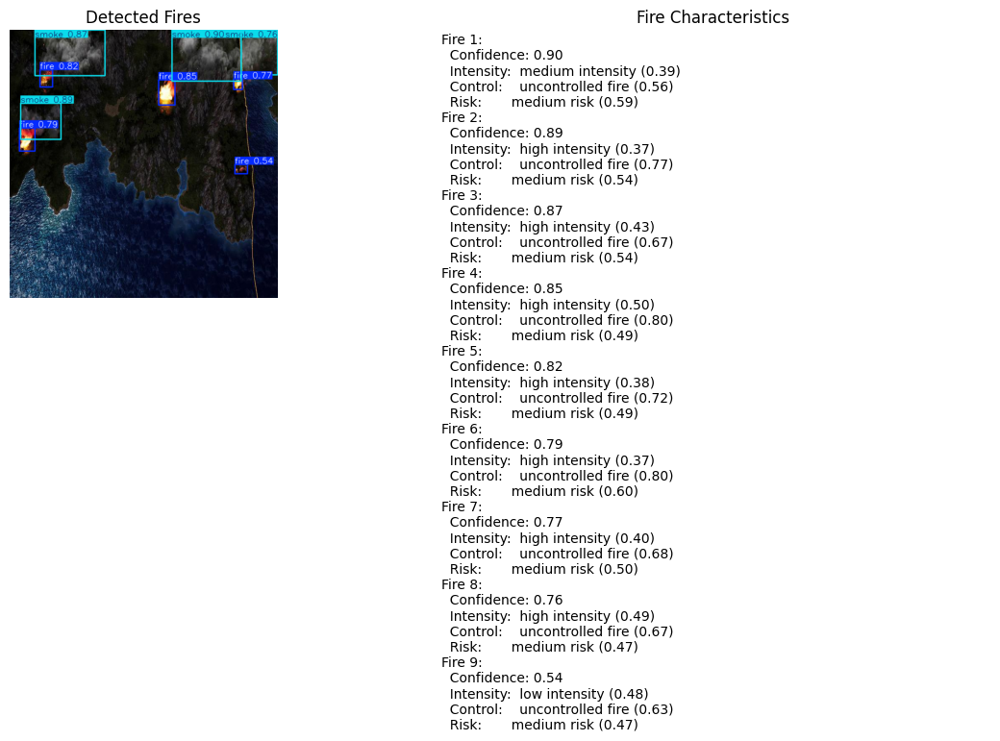


image 1/1 /kaggle/working/wildfire-detection--1/test/images/2-singlle_object_night_46_jpg.rf.2b89b0be02858fef34d378d3d09b6ec5.jpg: 640x640 1 fire, 1 smoke, 15.0ms
Speed: 3.4ms preprocess, 15.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


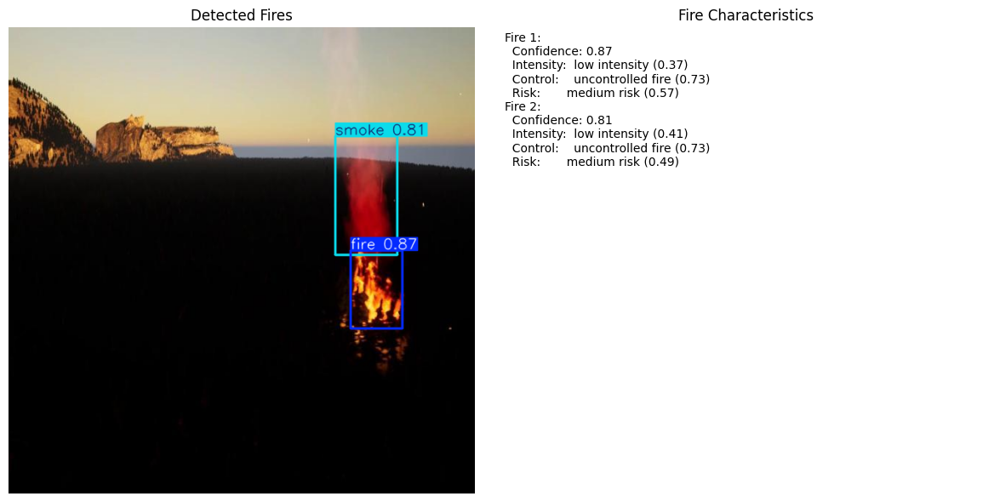


image 1/1 /kaggle/working/wildfire-detection--1/test/images/1_mountain_lake_daytime_3110_jpg.rf.6e4c0dc9607142a8d6abe642488060dd.jpg: 640x640 5 fires, 2 smokes, 15.0ms
Speed: 3.6ms preprocess, 15.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


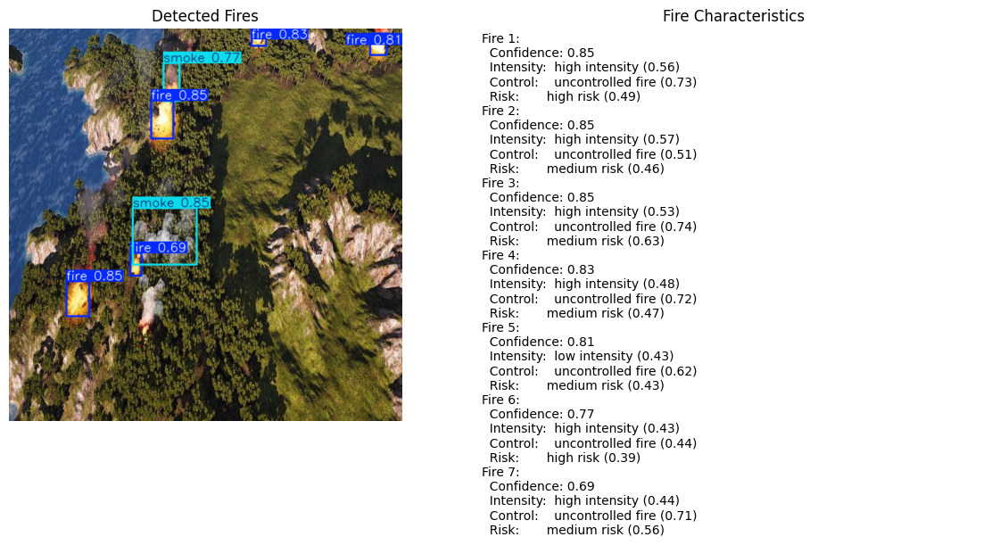


image 1/1 /kaggle/working/wildfire-detection--1/test/images/3-single_fire_45_jpg.rf.91002792586fd819407841cc1802e751.jpg: 640x640 1 fire, 1 smoke, 14.6ms
Speed: 3.2ms preprocess, 14.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


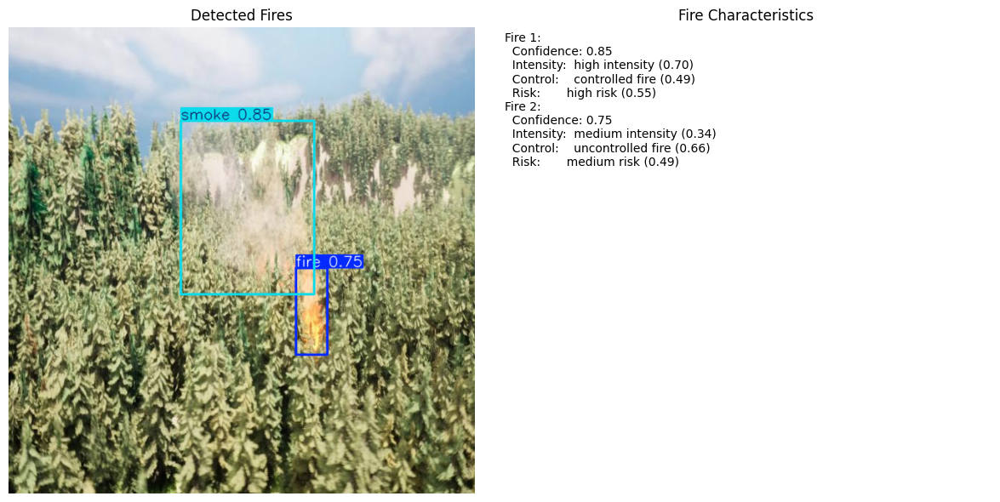


image 1/1 /kaggle/working/wildfire-detection--1/test/images/f-75-_jpg.rf.519d7fc17e0c1ec7d73fe5201e43bbe3.jpg: 640x640 6 fires, 14.5ms
Speed: 3.2ms preprocess, 14.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


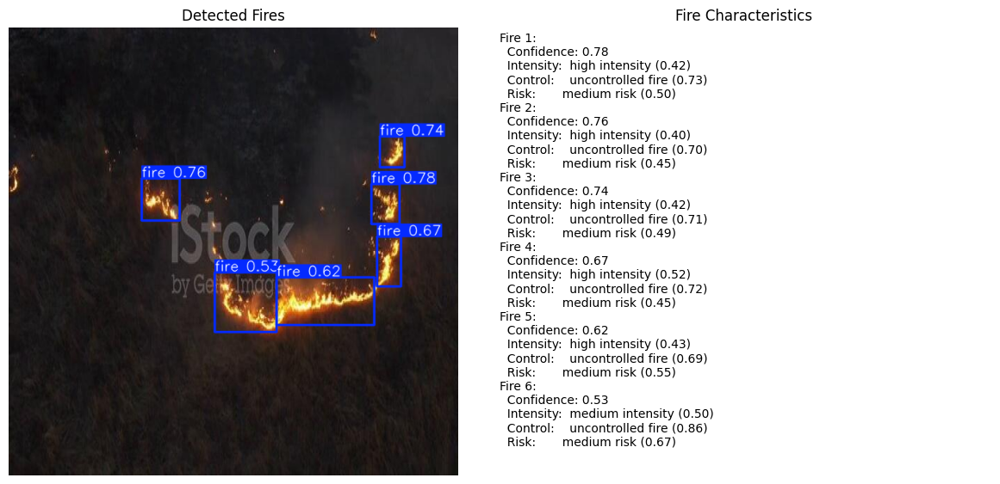


image 1/1 /kaggle/working/wildfire-detection--1/test/images/CBERS_4A_WFI_20200504_214_140_L4_5964_3328_2_png_jpg.rf.30014fad9064db85b1ebbdb5a623041a.jpg: 640x640 (no detections), 16.4ms
Speed: 1.9ms preprocess, 16.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


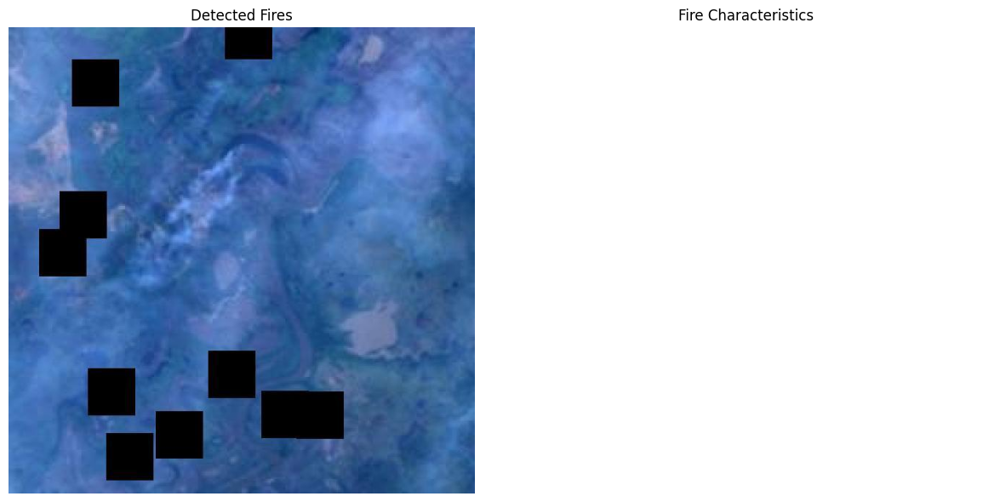


image 1/1 /kaggle/working/wildfire-detection--1/test/images/155A_gt_png.rf.5354362a95309096ae458fe04e754b8c.jpg: 640x640 1 fire, 16.3ms
Speed: 3.2ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


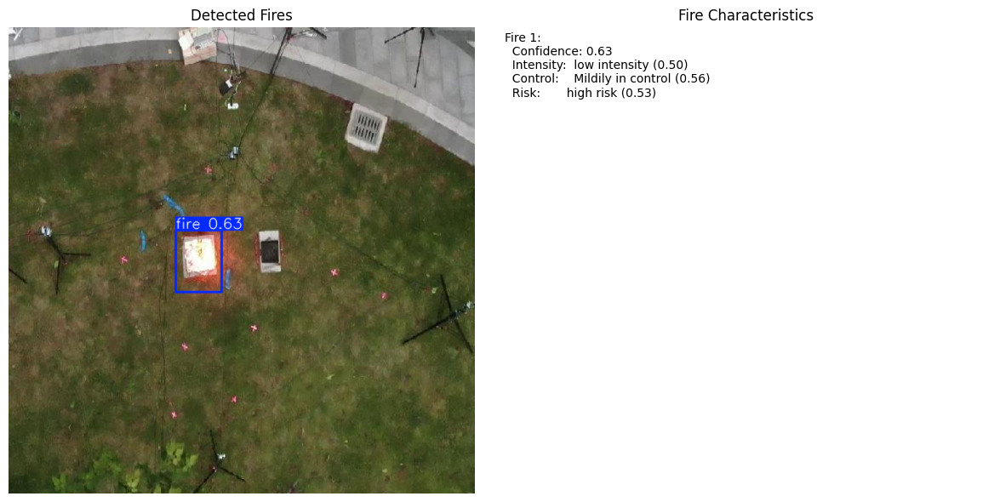


image 1/1 /kaggle/working/wildfire-detection--1/test/images/44_134_45_142__png.rf.f2614fbbb3674986deb8501edf607dd0.jpg: 640x640 4 fires, 16.4ms
Speed: 4.3ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


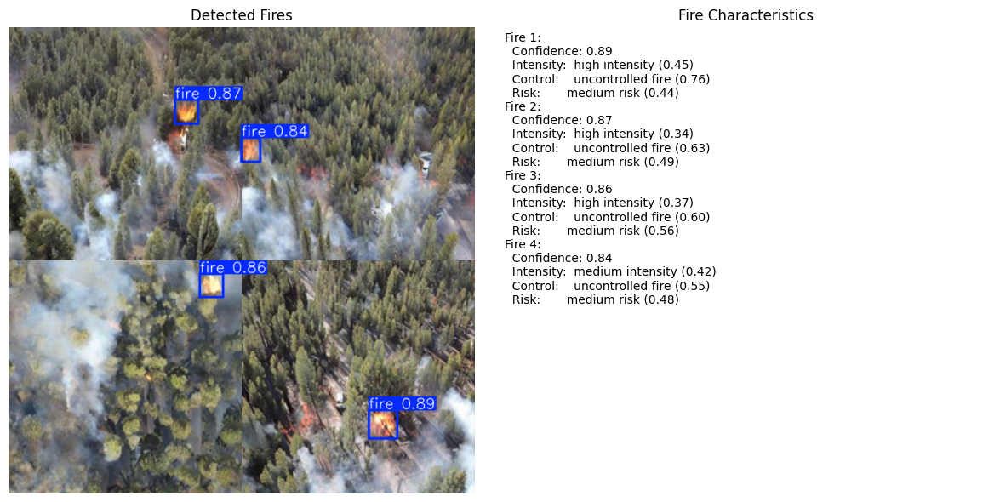


image 1/1 /kaggle/working/wildfire-detection--1/test/images/2-multi_object_day_178_jpg.rf.63837233d49daabab94d6d86457b7900.jpg: 640x640 2 fires, 1 smoke, 15.3ms
Speed: 3.1ms preprocess, 15.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


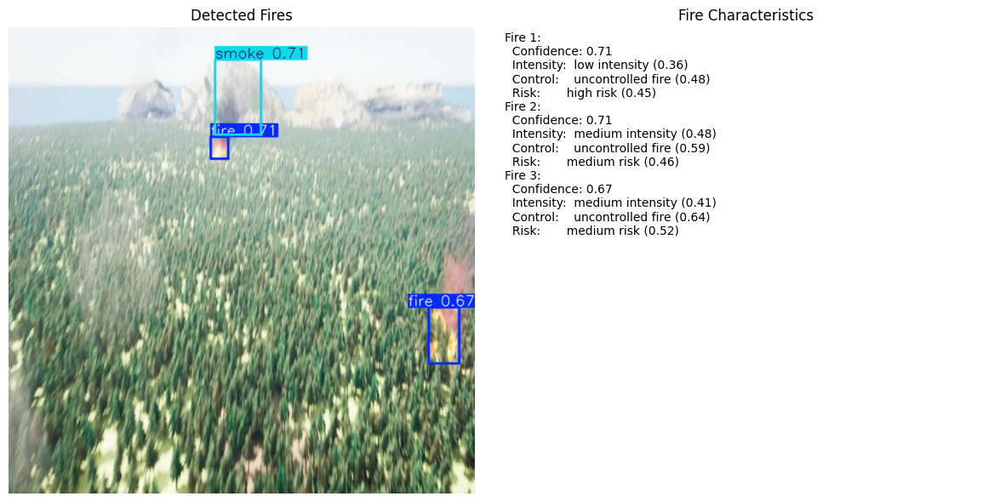

In [208]:
device = "cuda" if torch.cuda.is_available() else "cpu"

best_model = YOLO('/kaggle/working/runs/detect/fire_detection_small/weights/best.pt')
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
clip_model.to(device)

fire_prompts = {
    'intensity': [
        "a very small, contained fire, possibly just embers or a small flame",
        "a noticeable fire covering a moderate area, with visible flames and smoke",
        "a large, intense fire with significant flames, smoke, and potential for spreading"
    ],
    'control': [
        "a fire that is fully contained within a clear boundary, with active firefighting efforts visible",
        "a fire that is mostly contained but with some active flames or potential for spread",
        "an actively spreading wildfire with no visible containment efforts"
    ],
    'risk': [
        "a fire in a remote, unpopulated area posing minimal threat to people or property",
        "a fire burning near structures or infrastructure, posing a moderate threat",
        "a rapidly spreading fire directly threatening populated areas or critical infrastructure, requiring immediate action"
    ]
}

def analyze_fire_region(image_array):
    """Analyze a cropped fire region"""
    try:
        if image_array.max() <= 1.0:
            image_array = (image_array * 255).astype(np.uint8)
        image = Image.fromarray(image_array.astype(np.uint8))
        
        results = {}
        
        for characteristic, prompts in fire_prompts.items():
            inputs = processor(
                text=prompts,
                images=image,
                return_tensors="pt",
                padding=True,
                truncation=True
            ).to(device)
            
            with torch.no_grad():
                outputs = clip_model(**inputs)
                logits = outputs.logits_per_image
                probs = logits.softmax(dim=1).cpu().numpy()[0]
                
            results[characteristic] = {
                'prediction': prompts[np.argmax(probs)],
                'confidence': float(np.max(probs)),
                'all_probs': {p: float(v) for p, v in zip(prompts, probs)}
            }
        
        return results
    except Exception as e:
        print(f"Error in fire analysis: {e}")
        return None

base_path = "/kaggle/working/Fire-Detection-1"
test_images = glob(os.path.join(base_path, 'test', 'images', '*.jpg'))[:5]  

for img_path in random_images:
    
    results = best_model.predict(img_path, conf=0.5)
    
    img = Image.open(img_path).convert("RGB")

    analysis_text = []
    for i, box in enumerate(results[0].boxes):
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        crop = img.crop((x1, y1, x2, y2))

        inten_pred, inten_conf = classify_crop(crop, label_dict["intensity"])
        ctrl_pred,  ctrl_conf  = classify_crop(crop, label_dict["control"])
        risk_pred,  risk_conf  = classify_crop(crop, label_dict["risk"])

        analysis_text.append(f"Fire {i+1}:")
        analysis_text.append(f"  Confidence: {box.conf[0]:.2f}")
        analysis_text.append(f"  Intensity:  {inten_pred} ({inten_conf:.2f})")
        analysis_text.append(f"  Control:    {ctrl_pred} ({ctrl_conf:.2f})")
        analysis_text.append(f"  Risk:       {risk_pred} ({risk_conf:.2f})")

    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    res_plotted = results[0].plot()
    plt.imshow(res_plotted[..., ::-1])
    plt.axis('off')
    plt.title("Detected Fires")

    plt.subplot(1, 2, 2)

    plt.text(0.01, 0.99, "\n".join(analysis_text),
             va="top", fontsize=10)
    plt.axis('off')
    plt.title("Fire Characteristics")

    plt.tight_layout()
    plt.show()